- load data
- build labeled iterator
- build validation iterator
- build networks
- load pretrained network
- build PUMAP
- for each epoch
  - build umap graph
  - create data iterator
  - train epoch

In [1]:
# reload packages
%load_ext autoreload
%autoreload 2

### Choose GPU

In [2]:
%env CUDA_DEVICE_ORDER=PCI_BUS_ID
%env CUDA_VISIBLE_DEVICES=1

env: CUDA_DEVICE_ORDER=PCI_BUS_ID
env: CUDA_VISIBLE_DEVICES=1


In [3]:
import tensorflow as tf
gpu_devices = tf.config.experimental.list_physical_devices('GPU')
if len(gpu_devices)>0:
    tf.config.experimental.set_memory_growth(gpu_devices[0], True)
print(gpu_devices)

[PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]


In [4]:
tf.keras.backend.clear_session()

### dataset information

In [62]:
from datetime import datetime

dataset = "cifar10"
dims = (32, 32, 3)
umap_prop = 1.0
num_classes = 10
PROJECTION_DIMS = 1024
labels_per_class = 1  #'full'
datestring = datetime.now().strftime("%Y_%m_%d_%H_%M_%S_%f")
datestring = (
    str(dataset)
    + "_"
    + str(umap_prop)
    + "_"
    + str(PROJECTION_DIMS)
    + "_"
    + str(labels_per_class)
    + "____"
    + datestring
    + "__learned-metric_augmented"
)
print(datestring)

cifar10_1.0_1024_1____2020_08_06_21_42_37_899879__learned-metric_augmented


In [6]:
datestring = (
    str(dataset)
    + "_"
    + str(umap_prop)
    + "_"
    + str(PROJECTION_DIMS)
    + "_"
    + str(labels_per_class)
    + "____"
    + datestring
    + "__learned-metric_augmented"
)
print(datestring)

cifar10_1.0_1024_1____cifar10_1.0_1024_1____2020_08_06_21_42_37_899879__learned-metric_augmented__learned-metric_augmented


### Load packages

In [7]:
import tensorflow as tf
import numpy as np
import matplotlib.pyplot as plt
from tqdm.autonotebook import tqdm
from IPython import display
import pandas as pd
import umap
import copy
import os, tempfile

/mnt/cube/tsainbur/conda_envs/tpy3/lib/python3.6/site-packages/tqdm/autonotebook/__init__.py:14: TqdmExperimentalWarning: Using `tqdm.autonotebook.tqdm` in notebook mode. Use `tqdm.tqdm` instead to force console mode (e.g. in jupyter console)
  " (e.g. in jupyter console)", TqdmExperimentalWarning)


### Load dataset

In [8]:
from tfumap.load_datasets import load_CIFAR10, mask_labels

In [9]:
X_train, X_test, X_valid, Y_train, Y_test, Y_valid = load_CIFAR10(flatten=False)
X_train.shape

(40000, 32, 32, 3)

In [10]:
if labels_per_class == "full":
    X_labeled = X_train
    Y_masked = Y_labeled = Y_train
else:
    X_labeled, Y_labeled, Y_masked = mask_labels(
        X_train, Y_train, labels_per_class=labels_per_class
    )

### Build data iterators

In [11]:
from tfumap.umap import compute_cross_entropy, get_graph_elements
from tfumap.semisupervised import create_edge_iterator, create_validation_iterator, create_classification_iterator

In [12]:
batch_size = 256

In [13]:
img_data_gen = tf.keras.preprocessing.image.ImageDataGenerator(
    rotation_range=10,       # random rotation degrees
    width_shift_range=0.1,   # random shift 10%
    height_shift_range=0.1,
    horizontal_flip=True,
    brightness_range = (0.5, 1.5),
    ##rescale = 0.1,
    zoom_range = 0.2,
    rescale=1./255,  
    #shear_range = 6,
    ##zca_whitening = True,
)

In [14]:
labeled_batch_size = 128
labeled_iter = tf.data.Dataset.from_generator(
    lambda: img_data_gen.flow(X_labeled, y=Y_labeled, batch_size=labeled_batch_size),
    (tf.float32, tf.int32),
).prefetch(10)#.batch(10)

In [15]:
X, y = next(iter(labeled_iter))

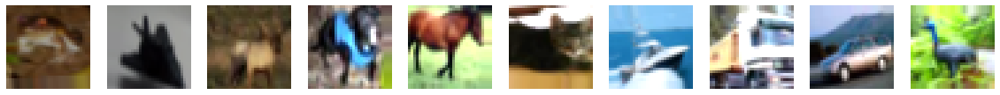

In [18]:
# view augmentations
nex = 10
fig, axs = plt.subplots(ncols=nex, figsize=(nex*2, 2))
for i in range(nex):
    axs[i].imshow(X[i])
    axs[i].axis('off')

In [19]:
data_valid, n_valid_samp = create_validation_iterator(X_valid, Y_valid, batch_size, repeat=True)

### Build network

In [20]:

from tensorflow.keras import layers
from tensorflow.keras.layers import Dense
from tensorflow.keras.layers import Conv2D
from tensorflow.keras.layers import AveragePooling2D
from tensorflow.keras.layers import Flatten
from tensorflow.keras.layers import MaxPool2D
from tensorflow.keras.layers import Input
from tensorflow.keras.layers import BatchNormalization
from tensorflow.keras.layers import Activation
from tensorflow.keras.models import Model
from tensorflow.keras.regularizers import l2

block_layers_num = 3
weight_decay = 1e-4
name = 'resnet20'
def conv2d_bn(x, filters, kernel_size, weight_decay=.0, strides=(1, 1)):
    layer = Conv2D(filters=filters,
                   kernel_size=kernel_size,
                   strides=strides,
                   padding='same',
                   use_bias=False,
                   kernel_regularizer=l2(weight_decay)
                   )(x)
    layer = BatchNormalization()(layer)
    return layer


def conv2d_bn_relu(x, filters, kernel_size, weight_decay=.0, strides=(1, 1)):
    layer = conv2d_bn(x, filters, kernel_size, weight_decay, strides)
    layer = Activation('relu')(layer)
    return layer


def ResidualBlock(x, filters, kernel_size, weight_decay, downsample=True):
    if downsample:
        # residual_x = conv2d_bn_relu(x, filters, kernel_size=1, strides=2)
        residual_x = conv2d_bn(x, filters, kernel_size=1, strides=2)
        stride = 2
    else:
        residual_x = x
        stride = 1
    residual = conv2d_bn_relu(x,
                              filters=filters,
                              kernel_size=kernel_size,
                              weight_decay=weight_decay,
                              strides=stride,
                              )
    residual = conv2d_bn(residual,
                         filters=filters,
                         kernel_size=kernel_size,
                         weight_decay=weight_decay,
                         strides=1,
                         )
    out = layers.add([residual_x, residual])
    out = Activation('relu')(out)
    return out



input_ = Input(shape=dims)
x =input_
x = conv2d_bn_relu(x, filters=16, kernel_size=(3, 3), weight_decay=weight_decay, strides=(1, 1))

# # conv 2
for i in range(block_layers_num):
    x = ResidualBlock(x, filters=16, kernel_size=(3, 3), weight_decay=weight_decay, downsample=False)
# # conv 3
x = ResidualBlock(x, filters=32, kernel_size=(3, 3), weight_decay=weight_decay, downsample=True)
for i in range(block_layers_num - 1):
    x = ResidualBlock(x, filters=32, kernel_size=(3, 3), weight_decay=weight_decay, downsample=False)
# # conv 4
x = ResidualBlock(x, filters=64, kernel_size=(3, 3), weight_decay=weight_decay, downsample=True)
for i in range(block_layers_num - 1):
    x = ResidualBlock(x, filters=64, kernel_size=(3, 3), weight_decay=weight_decay, downsample=False)
x = AveragePooling2D(pool_size=(8, 8), padding='valid')(x)
x = Flatten()(x)
encoder = Model(input_, x, name=name)

In [21]:
classifier = tf.keras.Sequential()
classifier.add(tf.keras.layers.InputLayer(input_shape=64))
classifier.add(tf.keras.layers.Dense(units=256, activation="relu"))
classifier.add(tf.keras.layers.Dense(units=256, activation="relu"))
classifier.add(tf.keras.layers.Dense(num_classes, activation='softmax', name="predictions"))

In [22]:
encoder.summary()

Model: "resnet20"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 32, 32, 3)]  0                                            
__________________________________________________________________________________________________
conv2d (Conv2D)                 (None, 32, 32, 16)   432         input_1[0][0]                    
__________________________________________________________________________________________________
batch_normalization (BatchNorma (None, 32, 32, 16)   64          conv2d[0][0]                     
__________________________________________________________________________________________________
activation (Activation)         (None, 32, 32, 16)   0           batch_normalization[0][0]        
___________________________________________________________________________________________

### load weights

In [23]:
from umap import UMAP

In [24]:
from tfumap.paths import MODEL_DIR

In [25]:
load_loc = "cifar10_0.0_1024_1____2020_08_01_17_21_58_145193_augmented"
encoder.load_weights((MODEL_DIR / 'semisupervised' / dataset / load_loc / "encoder").as_posix())
classifier.load_weights((MODEL_DIR / 'semisupervised' / dataset / load_loc / "classifier").as_posix())

### Look at pretrained state

In [26]:
def model_data(X, batch_size, model):
    """ embed a set of points in X to Z
    """
    n_batch = int(np.ceil(len(X) / batch_size))
    return np.vstack(
        [
                model(np.array(X[(i) * batch_size : (i + 1) * batch_size, :]))
            for i in tqdm(range(n_batch), leave=False)
        ]
    )

In [27]:
pred_model = tf.keras.models.Model(classifier.input,[classifier.get_layer(name="dense_1").get_output_at(0)])

In [28]:
z_enc = model_data(X_valid, 100, encoder)
last_layer_class = model_data(z_enc, batch_size, pred_model)
z_pred = model_data(z_enc, batch_size, classifier)
confidence = np.max(z_pred, axis = 1)

In [29]:
valid_acc = tf.keras.metrics.sparse_categorical_accuracy(
    Y_valid, z_pred
).numpy()
print(np.mean(valid_acc))

0.1535


In [30]:
umap_class = UMAP(verbose=True).fit_transform(last_layer_class)

UMAP(dens_frac=0.0, dens_lambda=0.0, verbose=True)
Construct fuzzy simplicial set
Thu Aug  6 21:43:15 2020 Finding Nearest Neighbors
Thu Aug  6 21:43:15 2020 Building RP forest with 10 trees
Thu Aug  6 21:43:16 2020 parallel NN descent for 13 iterations
	 0  /  13
	 1  /  13
Thu Aug  6 21:43:28 2020 Finished Nearest Neighbor Search
Thu Aug  6 21:43:32 2020 Construct embedding
	completed  0  /  500 epochs
	completed  50  /  500 epochs
	completed  100  /  500 epochs
	completed  150  /  500 epochs
	completed  200  /  500 epochs
	completed  250  /  500 epochs
	completed  300  /  500 epochs
	completed  350  /  500 epochs
	completed  400  /  500 epochs
	completed  450  /  500 epochs
Thu Aug  6 21:43:48 2020 Finished embedding


In [31]:
conf_thresh =  0.99
conf_mask = confidence > conf_thresh
umap_class_conf = UMAP(verbose=True).fit_transform(last_layer_class[conf_mask])

UMAP(dens_frac=0.0, dens_lambda=0.0, verbose=True)
Construct fuzzy simplicial set
Thu Aug  6 21:43:49 2020 Finding Nearest Neighbors
Thu Aug  6 21:43:49 2020 Building RP forest with 10 trees
Thu Aug  6 21:43:49 2020 parallel NN descent for 13 iterations
	 0  /  13
	 1  /  13
	 2  /  13
Thu Aug  6 21:43:50 2020 Finished Nearest Neighbor Search
Thu Aug  6 21:43:50 2020 Construct embedding
	completed  0  /  500 epochs
	completed  50  /  500 epochs
	completed  100  /  500 epochs
	completed  150  /  500 epochs
	completed  200  /  500 epochs
	completed  250  /  500 epochs
	completed  300  /  500 epochs
	completed  350  /  500 epochs
	completed  400  /  500 epochs
	completed  450  /  500 epochs
Thu Aug  6 21:44:05 2020 Finished embedding


In [32]:
classifications = np.argmax(z_pred, axis=1)
correctness = classifications == Y_valid

Text(0.5, 1.0, 'Confidence')

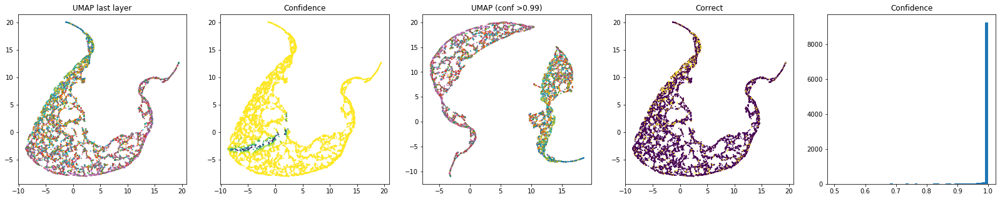

In [33]:
fig, axs = plt.subplots(ncols = 5, figsize=(28,5))
axs[0].scatter(umap_class[:,0], umap_class[:,1], s=1, c = Y_valid, cmap = plt.cm.tab10)
axs[0].set_title('UMAP last layer')
axs[1].scatter(umap_class[:,0], umap_class[:,1], s=1, c = confidence, cmap = plt.cm.viridis)
axs[1].set_title('Confidence')
axs[2].scatter(umap_class_conf[:,0], umap_class_conf[:,1], s=1, c = Y_valid[conf_mask], cmap = plt.cm.tab10)
axs[2].set_title('UMAP (conf >{})'.format(conf_thresh) )
axs[3].scatter(umap_class[:,0], umap_class[:,1], s=1, c = correctness, cmap = plt.cm.viridis)
axs[3].set_title('Correct')
axs[4].hist((confidence), bins = 50);
axs[4].set_title('Confidence')

In [34]:
len(z_pred[Y_valid])

10000

In [35]:
correct_pred =[i[j] for i,j in zip(z_pred, Y_valid)]

Text(0, 0.5, 'correct_pred')

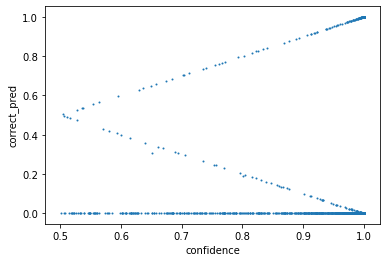

In [36]:
plt.scatter(confidence, correct_pred, s=1)
plt.xlabel('confidence')
plt.ylabel('correct_pred')

### Create UMAP object

In [37]:
from tfumap.semisupervised_model import PUMAP, compute_classifier_loss

In [38]:
def compute_umap_loss(
    batch_to,
    batch_from,
    encoder,
    _a,
    _b,
    negative_sample_rate=5,
    repulsion_strength=1,
):
    """
        compute the cross entropy loss for learning embeddings

        Parameters
        ----------
        batch_to : tf.int or tf.float32
            Either X or the index locations of the embeddings for verticies (to)
        batch_from : tf.int or tf.float32
            Either X or the index locations of the embeddings for verticies (from)

        Returns
        -------
        ce_loss : tf.float
            cross entropy loss for UMAP
        embedding_to : tf.float
            embeddings for verticies (to)
        embedding_from : tf.float
            embeddings for verticies (from)
        """

    # encode
    embedding_to = encoder(batch_to)
    embedding_from = encoder(batch_from)

    # get negative samples
    embedding_neg_to = tf.repeat(embedding_to, negative_sample_rate, axis=0)
    repeat_neg = tf.repeat(embedding_from, negative_sample_rate, axis=0)
    embedding_neg_from = tf.gather(
        repeat_neg, tf.random.shuffle(tf.range(tf.shape(repeat_neg)[0]))
    )

    #  distances between samples
    distance_embedding = tf.concat(
        [
            tf.norm(embedding_to - embedding_from, axis=1),
            tf.norm(embedding_neg_to - embedding_neg_from, axis=1),
        ],
        axis=0,
    )

    # convert probabilities to distances
    probabilities_distance = convert_distance_to_probability(distance_embedding, _a, _b)

    # treat positive samples as p=1, and negative samples as p=0
    probabilities_graph = tf.concat(
        [tf.ones(embedding_to.shape[0]), tf.zeros(embedding_neg_to.shape[0])], axis=0,
    )

    # cross entropy loss
    (attraction_loss, repellant_loss, ce_loss) = compute_cross_entropy(
        probabilities_graph,
        probabilities_distance,
        repulsion_strength=repulsion_strength,
    )

    return (
        attraction_loss,
        repellant_loss,
        ce_loss,
    )


In [39]:
import tensorflow as tf
from tfumap.umap import compute_cross_entropy, convert_distance_to_probability
from tfumap.semisupervised import (
    find_a_b,
    #compute_umap_loss,
    # compute_classifier_loss,
    batch_data,
)
import numpy as np
import os, tempfile
from tqdm.autonotebook import tqdm
from datetime import datetime


@tf.function
def compute_classifier_loss(X, y, encoder, classifier, sparse_ce, acc_func):
    """ compute the cross entropy loss for classification
        """
    d = classifier(encoder(X))
    loss = sparse_ce(y, d)
    acc = acc_func(y, d)
    #acc = tf.keras.metrics.sparse_categorical_accuracy(y, d)
    return loss, acc


class PUMAP(tf.keras.Model):
    def __init__(
        self,
        encoder,
        classifier,
        tensorboard_logdir=None,  # directory for tensorboard log
        min_dist=0.1,
        negative_sample_rate=5.0,
        optimizer=tf.keras.optimizers.SGD(0.1),
        repulsion_strength=1.0,
        # ** kwargs,
    ):
        super(PUMAP, self).__init__()
        # self.__dict__.update(kwargs)

        # subnetworks
        self.encoder = encoder
        self.classifier = classifier


        # optimizer for cross entropy minimization
        self.optimizer = optimizer
        self.repulsion_strength = repulsion_strength
        self.negative_sample_rate = negative_sample_rate

        # get a,b for current min_dist
        self._a, self._b = find_a_b(min_dist)

        # create summary writer to log loss information during training
        if tensorboard_logdir is None:
            self.tensorboard_logdir = os.path.join(
                tempfile.gettempdir(),
                "tensorboard",
                datetime.now().strftime("%Y%m%d-%H%M%S"),
            )
        else:
            self.tensorboard_logdir = tensorboard_logdir
        self.summary_writer_train = tf.summary.create_file_writer(
            self.tensorboard_logdir + "/train"
        )
        self.summary_writer_valid = tf.summary.create_file_writer(
            self.tensorboard_logdir + "/valid"
        )

        # sparse categorical cross entropy
        self.sparse_ce = tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True)
        self.class_acc = tf.keras.metrics.SparseCategoricalAccuracy()
        self.class_acc_val = tf.keras.metrics.SparseCategoricalAccuracy()

        # self.create_summary_metrics()

    @tf.function
    def train(self, batch_to, batch_from, X, y, umap_prop = 1.0, save_loss=False):
        """ One training step 
        Input are points and weights for positive and negative 
        samples for training. 
            
        """
        if umap_prop > 0:
            with tf.GradientTape() as tape:

                (attraction_loss, repellant_loss, umap_loss) = compute_umap_loss(
                    batch_to,
                    batch_from,
                    self.encoder,
                    self._a,
                    self._b,
                    self.negative_sample_rate,
                    self.repulsion_strength,
                )
            
                classifier_loss, classifier_acc = compute_classifier_loss(
                    X, y, self.encoder, self.classifier, self.sparse_ce, self.class_acc
                )
                loss = (
                    tf.reduce_mean(classifier_loss)
                    + tf.reduce_mean(umap_loss) * umap_prop
                )

            train_vars = (
                self.encoder.trainable_variables
                + self.classifier.trainable_variables
            )
        else:  # ignore running costly UMAP computations if not training on UMAP loss
            with tf.GradientTape() as tape:
                classifier_loss, classifier_acc = compute_classifier_loss(
                    X, y, self.encoder, self.classifier, self.sparse_ce, self.class_acc
                )
                loss = classifier_loss
            train_vars = (
                self.encoder.trainable_variables + self.classifier.trainable_variables
            )
            attraction_loss = repellant_loss = umap_loss = 0

        # compute gradient for umap
        grad = tape.gradient(loss, train_vars)

        # gradients are cliped in UMAP implementation. Any effect here?
        grad = [tf.clip_by_value(grad, -4.0, 4.0) for grad in grad]

        self.optimizer.apply_gradients(zip(grad, train_vars))

        return (
            attraction_loss,
            repellant_loss,
            tf.reduce_mean(umap_loss),
            classifier_loss,
            classifier_acc,
        )

    @tf.function
    def write_losses(
        self,
        step,
        classifier_acc,
        classifier_loss,
        umap_loss,
        classifier_loss_val,
        classifier_acc_val,
    ):
        # write train loss
        with self.summary_writer_train.as_default():
            tf.summary.scalar(
                "classif_acc", classifier_acc, step=step,
            )
            tf.summary.scalar(
                "classif_loss", classifier_loss, step=step,
            )
            tf.summary.scalar(
                "umap_loss", umap_loss, step=step,
            )
            self.summary_writer_train.flush()
        # write valid loss
        with self.summary_writer_valid.as_default():
            tf.summary.scalar(
                "classif_acc", classifier_acc_val, step=step,
            )
            tf.summary.scalar(
                "classif_loss", classifier_loss_val, step=step,
            )
            self.summary_writer_valid.flush()



In [40]:
### Initialize model
model = PUMAP(
    min_dist = 0.0,
    negative_sample_rate = 5, # how many negative samples per positive
    optimizer=tf.keras.optimizers.Adam(1e-3), # cross-entropy optimizer
    encoder=encoder,
    classifier=classifier,    
)

### plotting results

In [41]:
from tfumap.umap import retrieve_tensors
from sklearn.decomposition import PCA
import seaborn as sns
from umap import UMAP 

def plot_umap_classif_results(
    model,
    X_valid,
    Y_valid,
    X_train,
    X_labeled,
    Y_labeled,
    batch_size,
    dralg = PCA, #umap
    cmap="coolwarm",
    cmap2="bwr",
):
    # get loss dataframe from tensorboard
    try:
        loss_df = retrieve_tensors(model.tensorboard_logdir)
        losses_exist = True
    except ValueError as e:
        print(e)
        losses_exist = False

    pred_model = tf.keras.models.Model(model.classifier.input,[model.classifier.get_layer(name="dense_1").get_output_at(0)])

    # embed data
    enc_valid = model_data(X_valid, batch_size, model.encoder)
    class_valid = model_data(enc_valid, batch_size, pred_model)
    pred_valid = model_data(enc_valid, batch_size, model.classifier)

    enc_lab = model_data(X_labeled, batch_size, model.encoder)
    class_lab = model_data(enc_lab, batch_size, pred_model)
    pred_lab = model_data(enc_lab, batch_size, model.classifier)

    # get classifications and correctness
    classifications_valid = np.argmax(pred_valid, axis=1)
    correctness_valid = classifications_valid == Y_valid

    classifications_lab = np.argmax(pred_lab, axis=1)
    correctness_lab = classifications_lab == np.array(Y_labeled)

    confidence_lab  = np.max(pred_lab, axis=1)
    confidence_valid = np.max(pred_valid, axis=1)

    thresh = 0.0 #0.8
    mask_valid = confidence_valid > thresh
    mask_lab = confidence_lab > thresh

    # embed into 2D 
    dr = dralg()
    enc_valid_2 = dr.fit_transform(enc_valid[mask_valid])
    enc_lab_2 = dr.transform(enc_lab[mask_lab])



    dr = dralg()
    class_valid_2 = dr.fit_transform(class_valid[mask_valid])
    class_lab_2 = dr.transform(class_lab[mask_lab])
    
    fig, axs = plt.subplots(ncols=4, nrows=3, figsize=(14, 10), gridspec_kw = {'wspace':0, 'hspace':0})
    for row, (z_val, z_lab, z_title) in enumerate([
        [enc_valid_2, enc_lab_2, 'encoder'], 
        [class_valid_2, class_lab_2, 'last_layer_classifier'], 

    ]):
        for col, (y_valid, y_labeled, label_name) in enumerate([
            [Y_valid, Y_labeled, 'ground_truth'],
            [classifications_valid, classifications_lab, 'predictions'],
            [correctness_valid, correctness_lab, 'correctness'],
            [confidence_valid, confidence_lab, 'confidence'],
        ]):
            ax = axs[row, col]
            #ax.axis('off')
            if col == 0:
                ax.set_ylabel(z_title)
            if row == 0:
                ax.set_title(label_name)
            #ax.set_title(z_title + '_' + label_name)
            ax.scatter(
                z_val[:, 0],
                z_val[:, 1],
                c=y_valid[mask_valid],
                cmap=cmap if label_name not in ["correctness", "confidence"]  else 'viridis',  # "tab10"
                s=2,
                alpha=0.25,
                rasterized=True,
            )
            if False:
                ax.scatter(
                    z_lab[:, 0],
                    z_lab[:, 1],
                    c=y_labeled[mask_lab],
                    cmap=cmap if label_name not in ["correctness", "confidence"] else 'viridis',  # "tab10"
                    s=20,
                    alpha=0.25,
                    rasterized=True,
                )
            ax.set_xticks([])
            ax.set_yticks([])
        
    plt.show()
    
    fig, axs = plt.subplots(ncols=3, figsize=(13.4,3))
    if losses_exist:
        ax = axs[0]
        sns.lineplot(
            x="step",
            y="val",
            hue="group",
            data=loss_df[loss_df.variable == "umap_loss"],
            ci=None,
            legend=None,
            ax=ax,
        )
        ax.legend(loc="upper right")
        ax.set_xscale("log")
        ax.set_title("UMAP loss", fontsize=24)
        ax.set_ylabel("Cross Entropy")
        
        ax = axs[1]
        sns.lineplot(
            x="step",
            y="val",
            hue="group",
            data=loss_df[loss_df.variable == "classif_loss"],
            ci=None,
            legend=None,
            ax=ax,
        )
        ax.set_xscale("log")
        ax.legend(loc="upper right")
        # ax.set_yscale("log")
        ax.set_title("Classif loss", fontsize=24)
        ax.set_ylabel("Cross Entropy")
        
        ax = axs[2]
        sns.lineplot(
            x="step",
            y="val",
            hue="group",
            data=loss_df[loss_df.variable == "classif_acc"],
            ci=None,
            legend=None,
            ax=ax,
        )
        ax.set_xscale("log")
        ax.legend(loc="lower right")
        ax.set_title("Classif acc", fontsize=24)
        ax.set_ylabel("Acc")
    plt.show()

No objects to concatenate


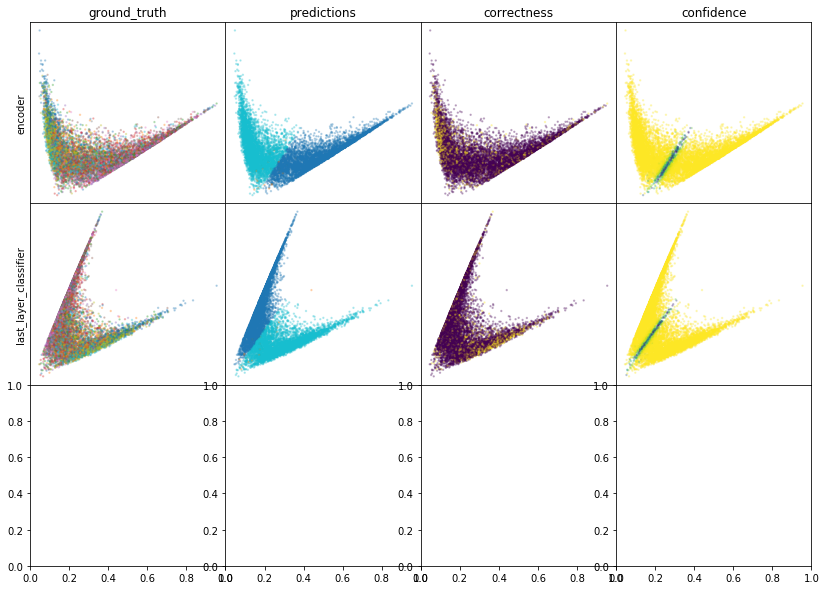

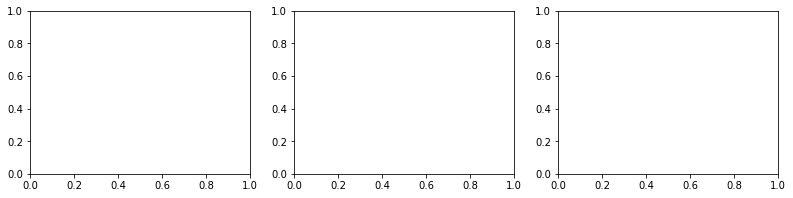

In [42]:
plot_umap_classif_results(model, X_valid, Y_valid, X_train, X_labeled, Y_labeled, batch_size, dralg=PCA, cmap='tab10', cmap2='tab10')

In [43]:
for i in tqdm(range(100)):
    test = next(img_data_gen.flow(X_labeled[:128], batch_size=128, shuffle=False))

In [44]:
def create_edge_iterator(
    head, tail, weight, batch_size, max_sample_repeats_per_epoch=25
):
    """ create an iterator for edges
    """
    # set the maximum number of times each edge should be repeated per epoch
    epochs_per_sample = np.clip(
        (weight / np.max(weight)) * max_sample_repeats_per_epoch,
        1,
        max_sample_repeats_per_epoch,
    ).astype("int")

    edges_to_exp, edges_from_exp = (
        np.repeat(head, epochs_per_sample.astype("int")),
        np.repeat(tail, epochs_per_sample.astype("int")),
    )

    # permutate
    perm_mask = np.random.permutation(range(len(edges_to_exp)))
    edges_to_exp = edges_to_exp[perm_mask]
    edges_from_exp = edges_from_exp[perm_mask]

    def augmentation_generator():  # edges_to, edges_from, batch_size
        """
        https://github.com/keras-team/keras/issues/5834
        """
        
        img_data_gen = tf.keras.preprocessing.image.ImageDataGenerator(
            rotation_range=10,       # random rotation degrees
            width_shift_range=0.1,   # random shift 10%
            height_shift_range=0.1,
            horizontal_flip=True,
            brightness_range = (0.5, 1.5),
            ##rescale = 0.1,
            zoom_range = 0.2,
            rescale=1./255,  
            #shear_range = 6,
            ##zca_whitening = True,
        )
        
        n_batches = int(len(edges_from_exp) / batch_size)
        to_batches = np.reshape(
            edges_to_exp[: n_batches * batch_size], (n_batches, batch_size)
        )
        from_batches = np.reshape(
            edges_from_exp[: n_batches * batch_size], (n_batches, batch_size)
        )
        for batch_to, batch_from in zip(to_batches, from_batches):
            # yield X_train[batch_to], X_train[batch_from]
            yield (
                next(
                    img_data_gen.flow(
                        X_train[batch_to], batch_size=batch_size, shuffle=False
                    )
                ),
                next(
                    img_data_gen.flow(
                        X_train[batch_from], batch_size=batch_size, shuffle=False
                    )
                ),
            )

    nthreads = 10
    edge_iter = tf.data.Dataset.from_tensor_slices(
        ["Gen_" + str(i) for i in range(nthreads)]
    )
    edge_iter = ds.interleave(
        lambda x: tf.data.Dataset.from_generator(
            augmentation_generator, (tf.float32, tf.float32)
        ),
        cycle_length=nthreads,
        block_length=1,
        num_parallel_calls=nthreads,
    )

    return edge_iter, len(edges_to_exp)

In [45]:
def create_edge_iterator(
    head, tail, weight, batch_size, max_sample_repeats_per_epoch=25
):
    """ create an iterator for edges
    """
    # set the maximum number of times each edge should be repeated per epoch
    epochs_per_sample = np.clip(
        (weight / np.max(weight)) * max_sample_repeats_per_epoch,
        1,
        max_sample_repeats_per_epoch,
    ).astype("int")

    edges_to_exp, edges_from_exp = (
        np.repeat(head, epochs_per_sample.astype("int")),
        np.repeat(tail, epochs_per_sample.astype("int")),
    )

    # permutate
    perm_mask = np.random.permutation(range(len(edges_to_exp)))
    edges_to_exp = edges_to_exp[perm_mask]
    edges_from_exp = edges_from_exp[perm_mask]

        
    edge_iter = (
        tf.data.Dataset.from_tensor_slices((edges_to_exp, edges_from_exp))
    ).batch(batch_size).prefetch(5)
    
    return edge_iter, len(edges_to_exp)

In [46]:
pred_model = tf.keras.models.Model(
        model.classifier.input,
        [model.classifier.get_layer(name="dense_1").get_output_at(0)],
    )

In [47]:
N_EPOCHS = 50
n_neighbors=15
batch_size = 256 # 500
max_sample_repeats_per_epoch = 25
max_save_delta = 0.005

In [48]:
from tfumap.semisupervised import build_fuzzy_simplicial_set

In [49]:
from tfumap.paths import MODEL_DIR

In [69]:
# where to save checkpoints
cpt_path = MODEL_DIR / 'semisupervised' / dataset / datestring

In [51]:
patience = 10000 # wait this many batches without improvement before early stopping
min_delta = 0.0001 # threshold for what counts as an improvement
best_acc = 0 # the best current accuracy score
best_saved_acc = 0 # best accuracy on valid data that has been checkpointed
best_saved_batch = 0 # batch number for last good batch
max_reinitialize_delta = .01 # minimum loss in accuracy resulting in reinitialized weights
plot_frequency = 1000 # how frequently to plot
max_reloads = 10 # how often can we reload weights?
batch = 0; epoch = 0
batches_since_last_reload = 0

In [52]:
epochs_without_improvement = 0
max_epochs_without_improvement = 5 # allow the network 
reload_tolerance = 100 # allow the network at least reload_tolerance batches before reloading last weights

In [53]:
repeat_augment_tolerance = 25 # augmentations are allowed to be repeated up until this many times 
# we could also have a bank of sampleable augmentations per exemplar

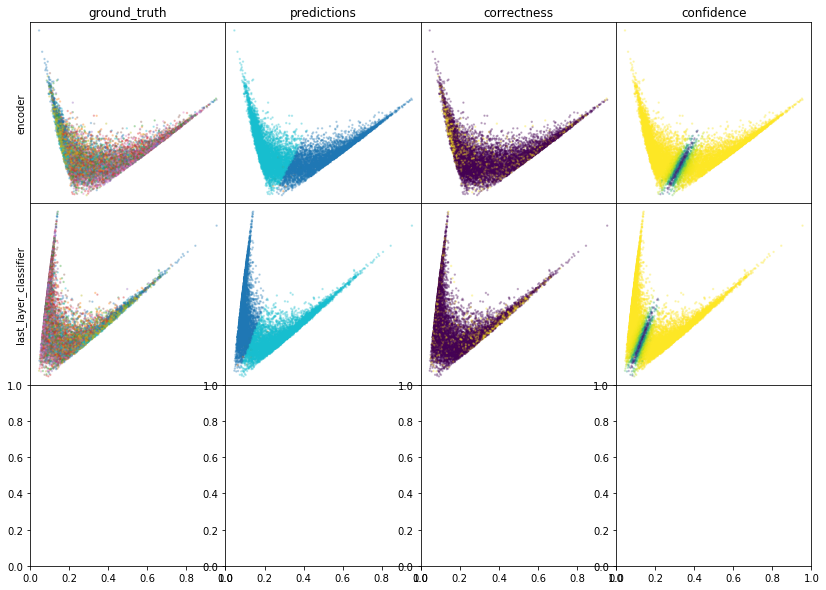

W0806 21:45:35.051924 139770049615616 legend.py:1282] No handles with labels found to put in legend.
/mnt/cube/tsainbur/conda_envs/tpy3/lib/python3.6/site-packages/ipykernel_launcher.py:118: UserWarning: Data has no positive values, and therefore cannot be log-scaled.
/mnt/cube/tsainbur/conda_envs/tpy3/lib/python3.6/site-packages/ipykernel_launcher.py:132: UserWarning: Data has no positive values, and therefore cannot be log-scaled.
W0806 21:45:35.109826 139770049615616 legend.py:1282] No handles with labels found to put in legend.
/mnt/cube/tsainbur/conda_envs/tpy3/lib/python3.6/site-packages/ipykernel_launcher.py:148: UserWarning: Data has no positive values, and therefore cannot be log-scaled.
W0806 21:45:35.164630 139770049615616 legend.py:1282] No handles with labels found to put in legend.


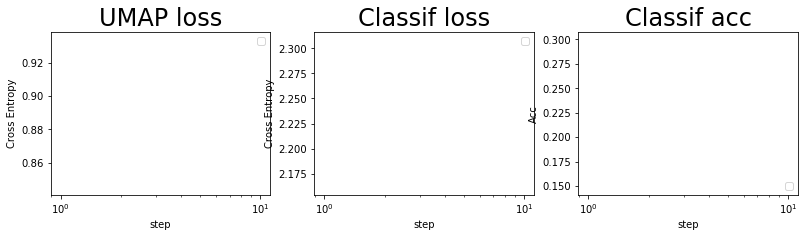

batch: 0 | train acc: 0.3 | val acc: 0.1484
saving weights | batch = 100 | acc = 14.933


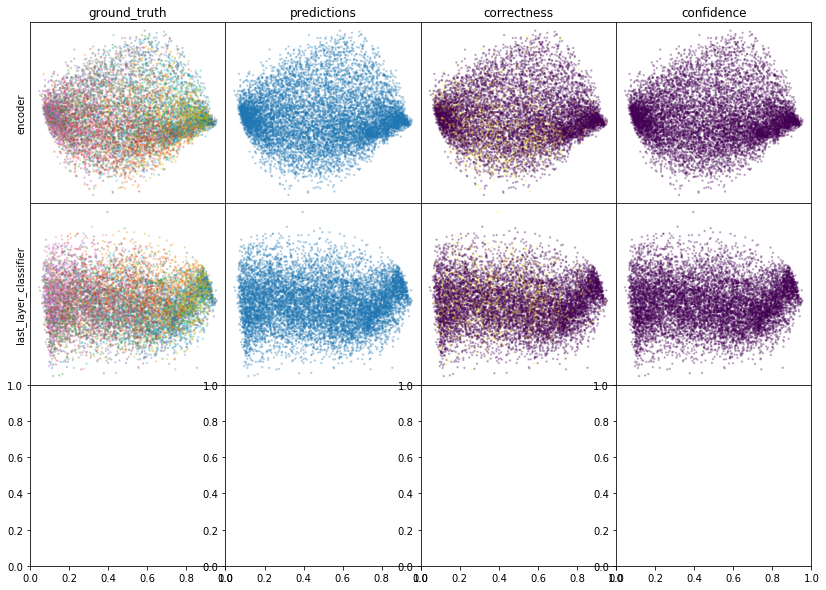

W0806 21:51:11.856133 139770049615616 legend.py:1282] No handles with labels found to put in legend.
W0806 21:51:11.913482 139770049615616 legend.py:1282] No handles with labels found to put in legend.
W0806 21:51:11.973822 139770049615616 legend.py:1282] No handles with labels found to put in legend.


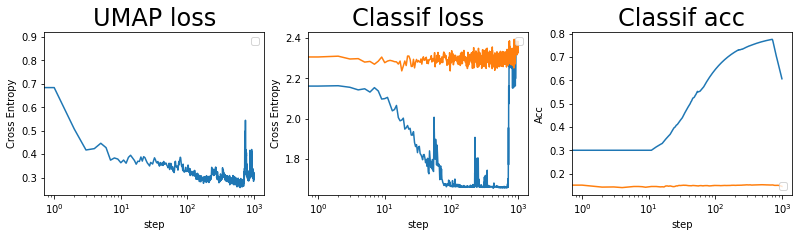

batch: 1000 | train acc: 0.6067 | val acc: 0.1451
batch 1153 | acc = 0.139 | learn rate = 0.0010000000474974513 | reloading weights from batch 100 at acc 14 | n reloads = 0


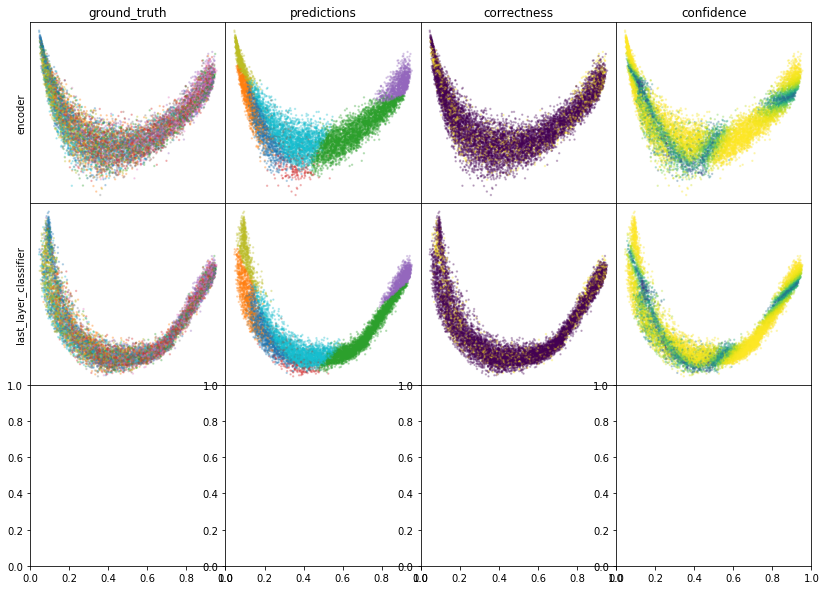

W0806 21:57:21.683979 139770049615616 legend.py:1282] No handles with labels found to put in legend.
W0806 21:57:21.742657 139770049615616 legend.py:1282] No handles with labels found to put in legend.
W0806 21:57:21.802137 139770049615616 legend.py:1282] No handles with labels found to put in legend.


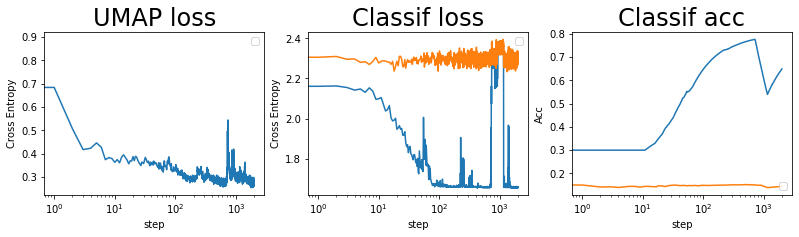

batch: 2000 | train acc: 0.6487 | val acc: 0.1441


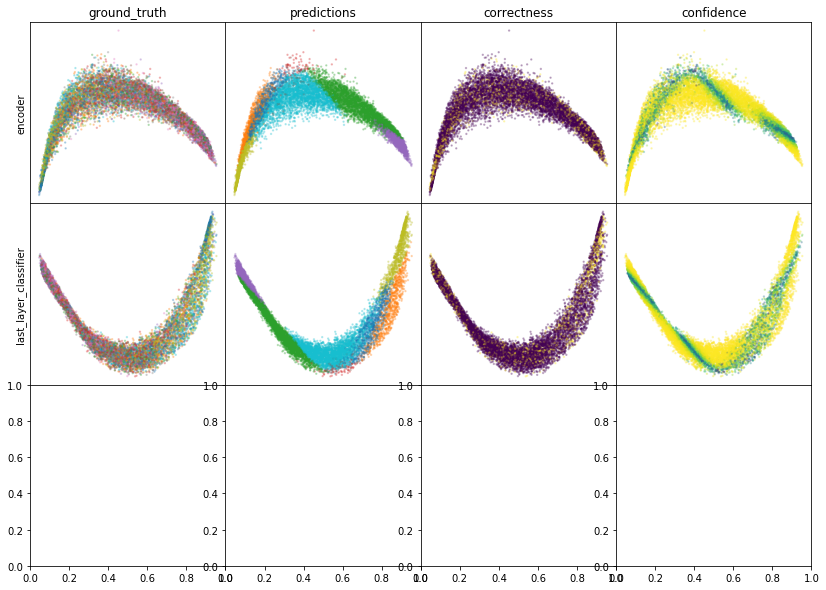

W0806 22:02:59.738112 139770049615616 legend.py:1282] No handles with labels found to put in legend.
W0806 22:02:59.803616 139770049615616 legend.py:1282] No handles with labels found to put in legend.
W0806 22:02:59.870596 139770049615616 legend.py:1282] No handles with labels found to put in legend.


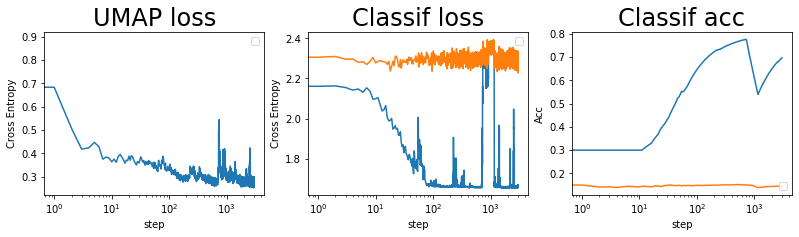

batch: 3000 | train acc: 0.6962 | val acc: 0.1468


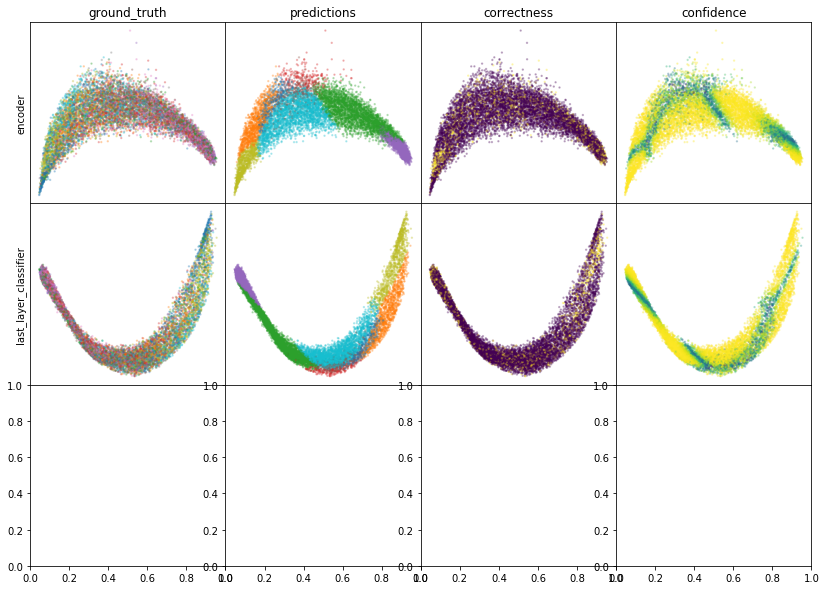

W0806 22:09:10.713769 139770049615616 legend.py:1282] No handles with labels found to put in legend.
W0806 22:09:10.777880 139770049615616 legend.py:1282] No handles with labels found to put in legend.
W0806 22:09:10.842635 139770049615616 legend.py:1282] No handles with labels found to put in legend.


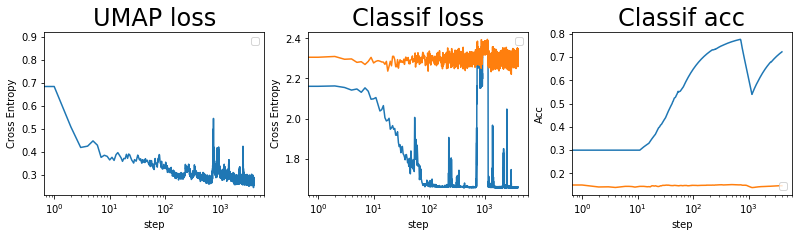

batch: 4000 | train acc: 0.7222 | val acc: 0.1473


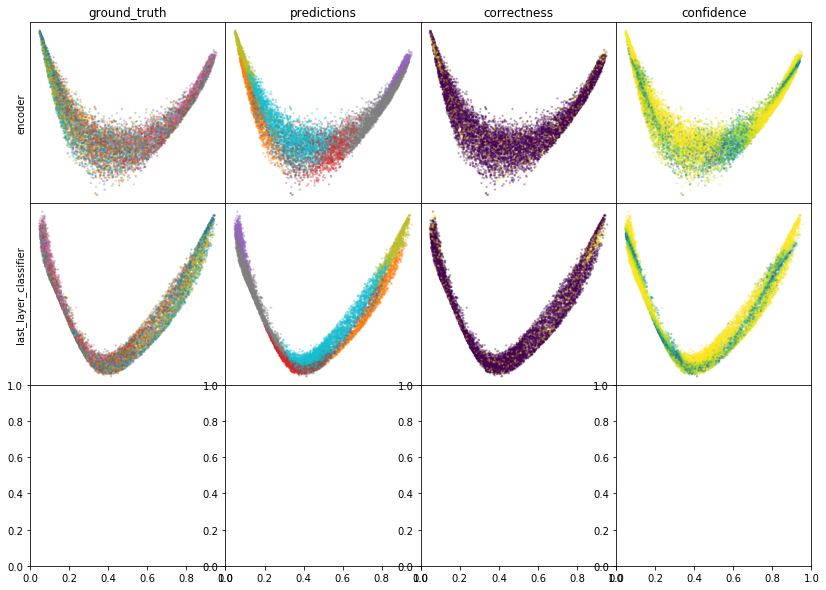

W0806 22:14:49.512789 139770049615616 legend.py:1282] No handles with labels found to put in legend.
W0806 22:14:49.581193 139770049615616 legend.py:1282] No handles with labels found to put in legend.
W0806 22:14:49.653094 139770049615616 legend.py:1282] No handles with labels found to put in legend.


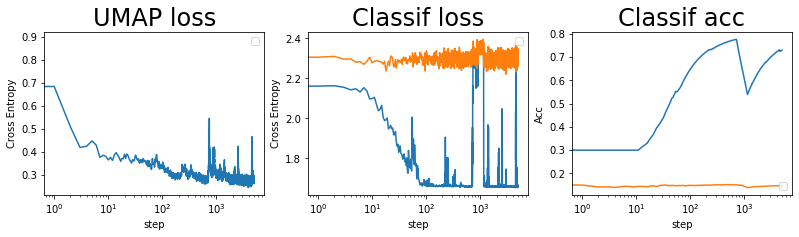

batch: 5000 | train acc: 0.7295 | val acc: 0.1471


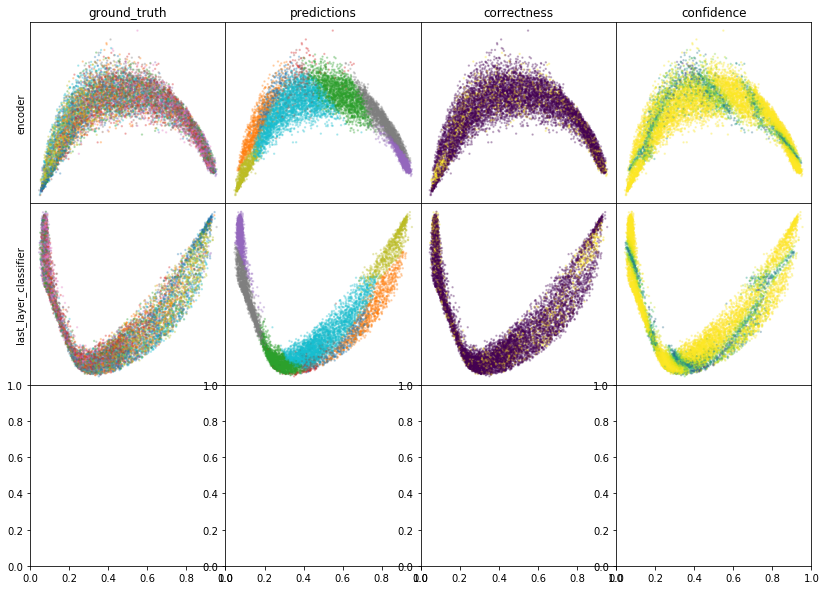

W0806 22:20:59.976092 139770049615616 legend.py:1282] No handles with labels found to put in legend.
W0806 22:21:00.047790 139770049615616 legend.py:1282] No handles with labels found to put in legend.
W0806 22:21:00.121628 139770049615616 legend.py:1282] No handles with labels found to put in legend.


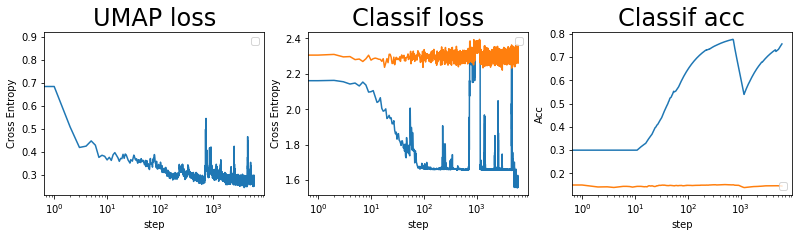

batch: 6000 | train acc: 0.7561 | val acc: 0.1459


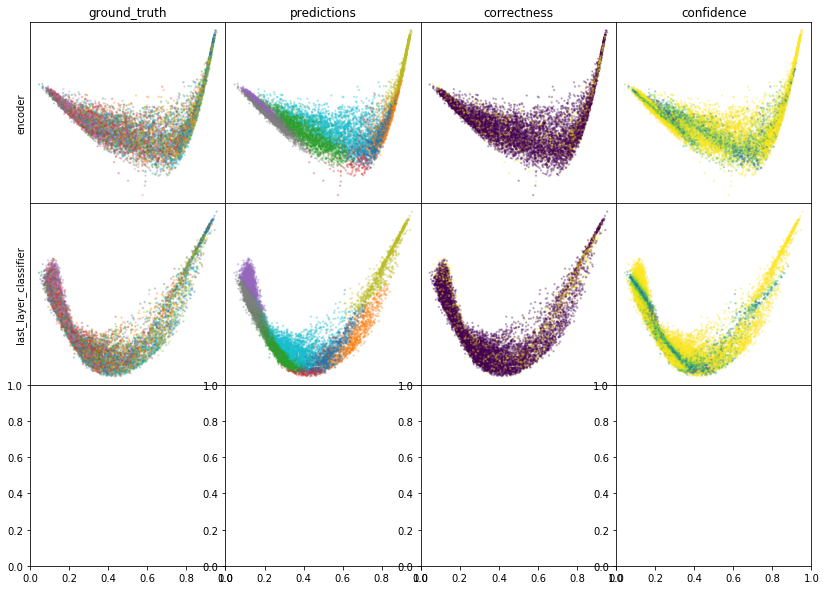

W0806 22:26:37.641444 139770049615616 legend.py:1282] No handles with labels found to put in legend.
W0806 22:26:37.712784 139770049615616 legend.py:1282] No handles with labels found to put in legend.
W0806 22:26:37.784190 139770049615616 legend.py:1282] No handles with labels found to put in legend.


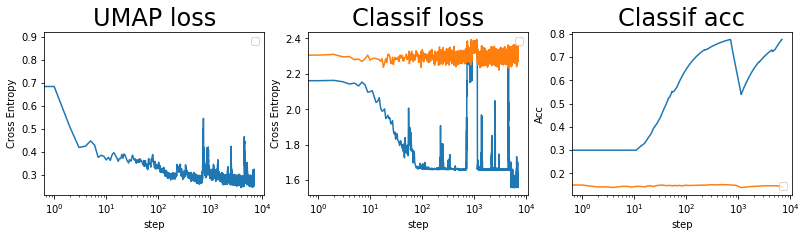

batch: 7000 | train acc: 0.7764 | val acc: 0.1448


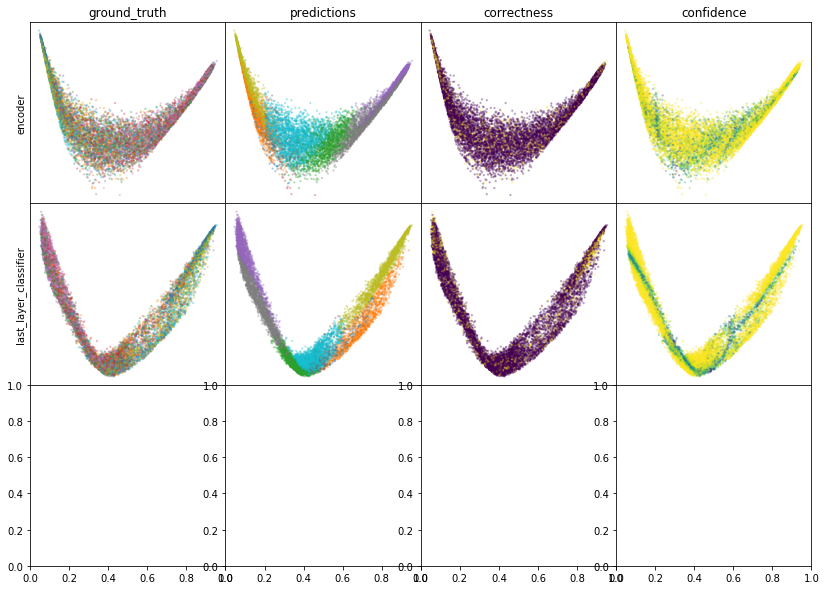

W0806 22:32:50.943485 139770049615616 legend.py:1282] No handles with labels found to put in legend.
W0806 22:32:51.022332 139770049615616 legend.py:1282] No handles with labels found to put in legend.
W0806 22:32:51.100883 139770049615616 legend.py:1282] No handles with labels found to put in legend.


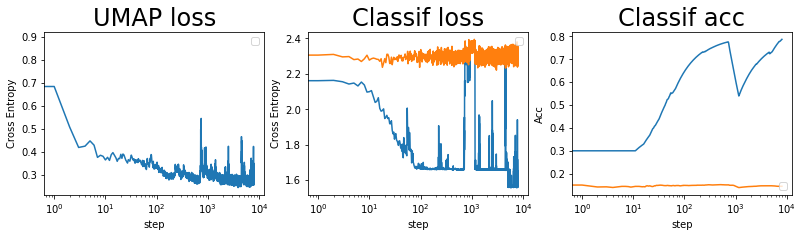

batch: 8000 | train acc: 0.7869 | val acc: 0.1451


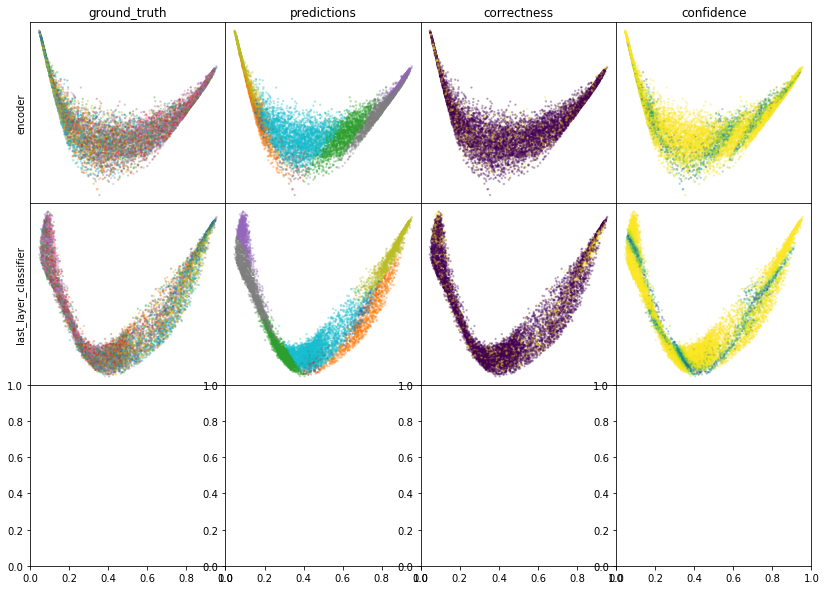

W0806 22:38:30.256815 139770049615616 legend.py:1282] No handles with labels found to put in legend.
W0806 22:38:30.332705 139770049615616 legend.py:1282] No handles with labels found to put in legend.
W0806 22:38:30.408140 139770049615616 legend.py:1282] No handles with labels found to put in legend.


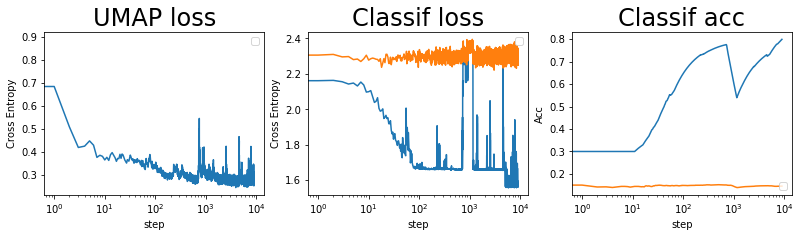

batch: 9000 | train acc: 0.7992 | val acc: 0.1459


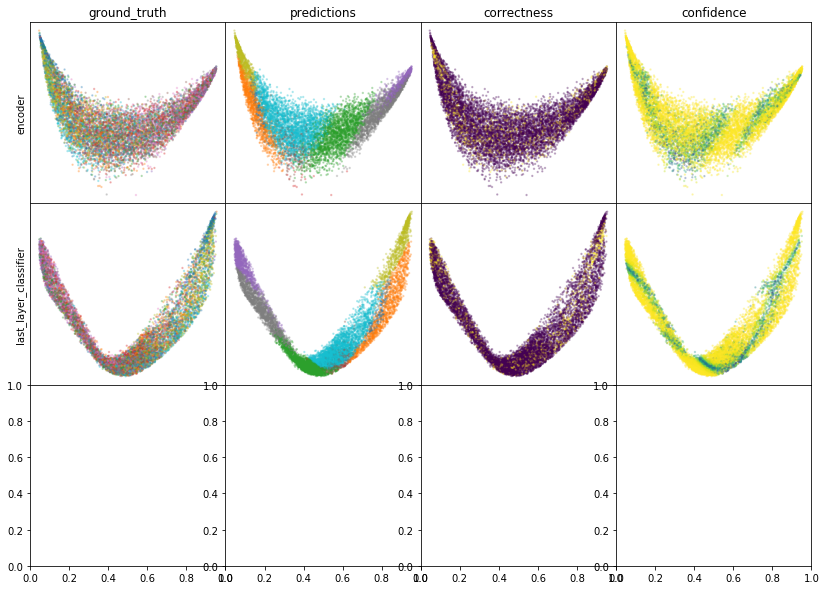

W0806 22:44:45.305681 139770049615616 legend.py:1282] No handles with labels found to put in legend.
W0806 22:44:45.392964 139770049615616 legend.py:1282] No handles with labels found to put in legend.
W0806 22:44:45.474760 139770049615616 legend.py:1282] No handles with labels found to put in legend.


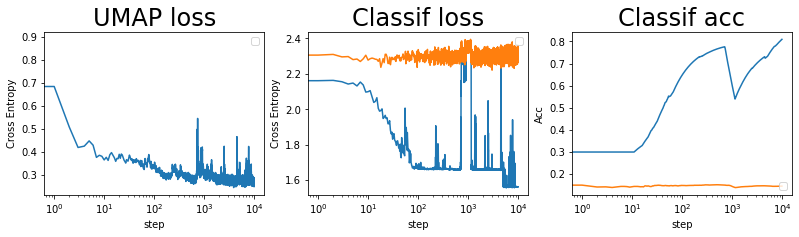

batch: 10000 | train acc: 0.8093 | val acc: 0.1459
leaving epoch because no improvement in 10000 batches


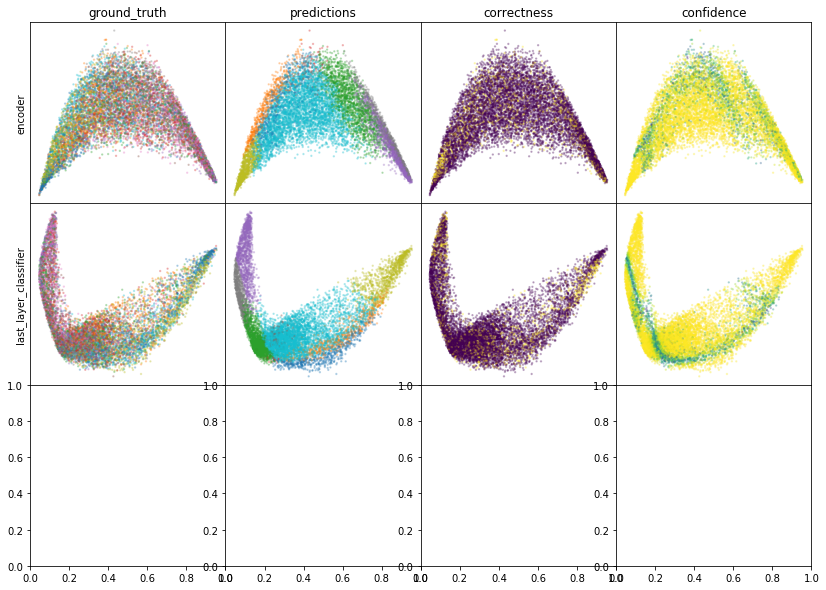

W0806 22:51:16.198369 139770049615616 legend.py:1282] No handles with labels found to put in legend.
W0806 22:51:16.281303 139770049615616 legend.py:1282] No handles with labels found to put in legend.
W0806 22:51:16.365836 139770049615616 legend.py:1282] No handles with labels found to put in legend.


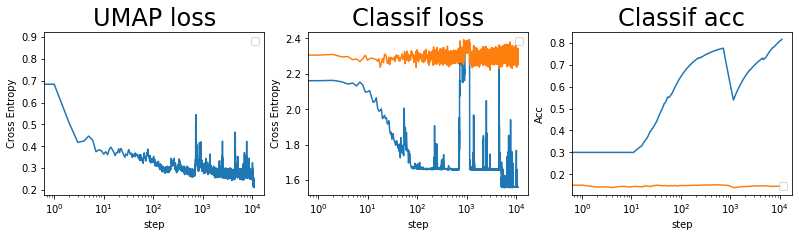

batch: 11000 | train acc: 0.8163 | val acc: 0.147


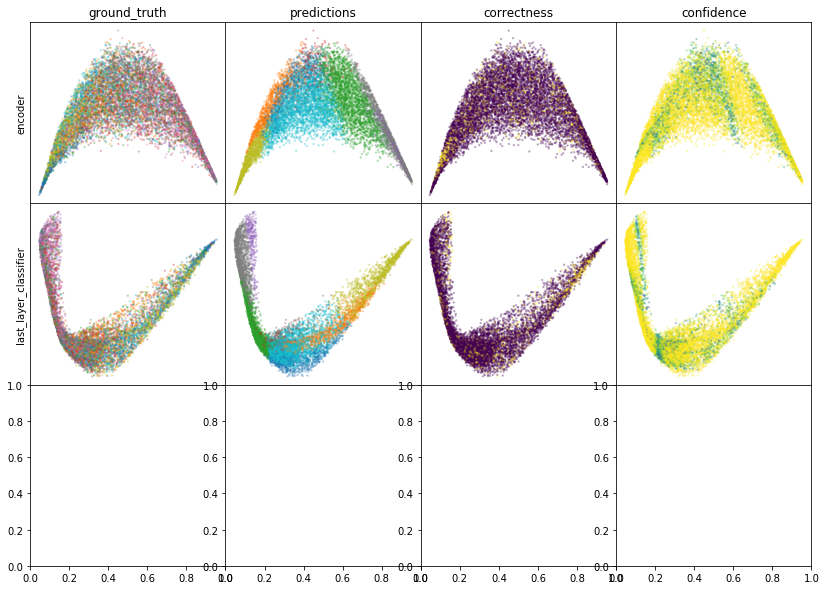

W0806 22:56:57.396949 139770049615616 legend.py:1282] No handles with labels found to put in legend.
W0806 22:56:57.483155 139770049615616 legend.py:1282] No handles with labels found to put in legend.
W0806 22:56:57.569157 139770049615616 legend.py:1282] No handles with labels found to put in legend.


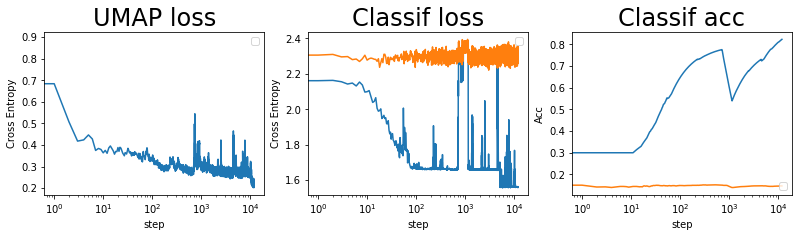

batch: 12000 | train acc: 0.8233 | val acc: 0.147


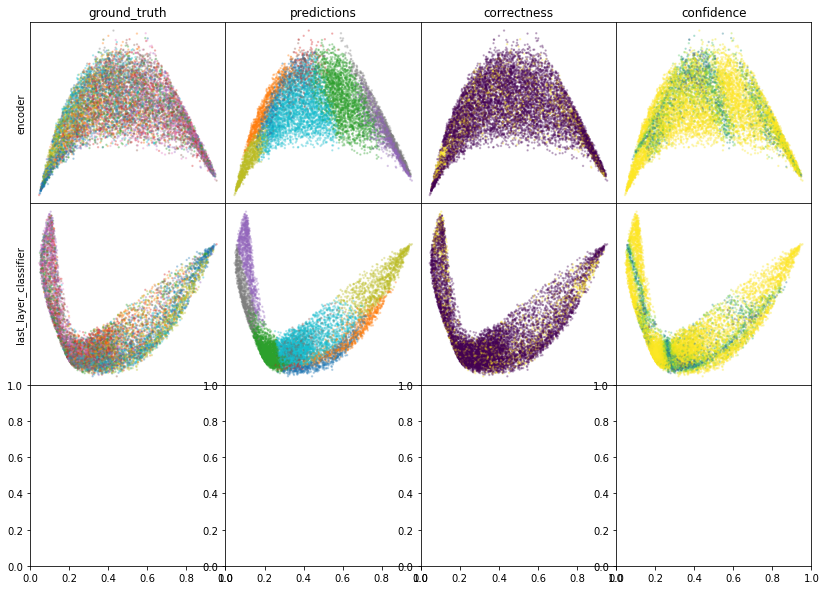

W0806 23:03:12.849078 139770049615616 legend.py:1282] No handles with labels found to put in legend.
W0806 23:03:12.941042 139770049615616 legend.py:1282] No handles with labels found to put in legend.
W0806 23:03:13.036000 139770049615616 legend.py:1282] No handles with labels found to put in legend.


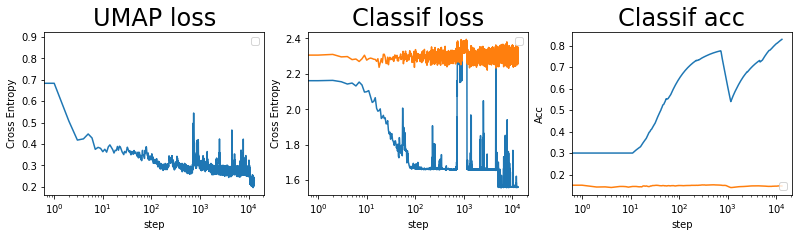

batch: 13000 | train acc: 0.8292 | val acc: 0.1467


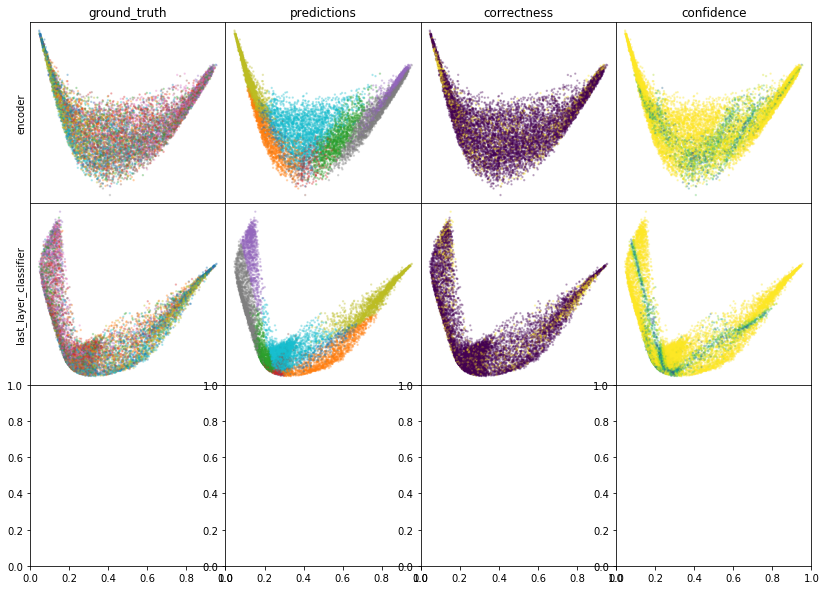

W0806 23:08:55.047938 139770049615616 legend.py:1282] No handles with labels found to put in legend.
W0806 23:08:55.141261 139770049615616 legend.py:1282] No handles with labels found to put in legend.
W0806 23:08:55.233311 139770049615616 legend.py:1282] No handles with labels found to put in legend.


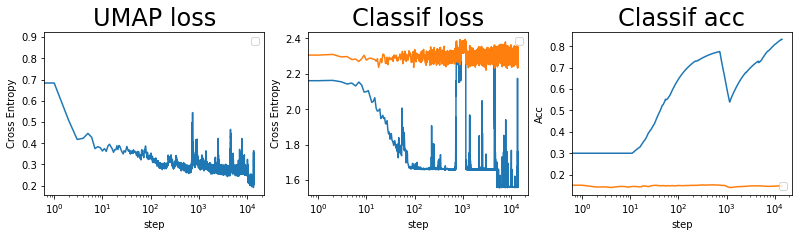

batch: 14000 | train acc: 0.8329 | val acc: 0.147


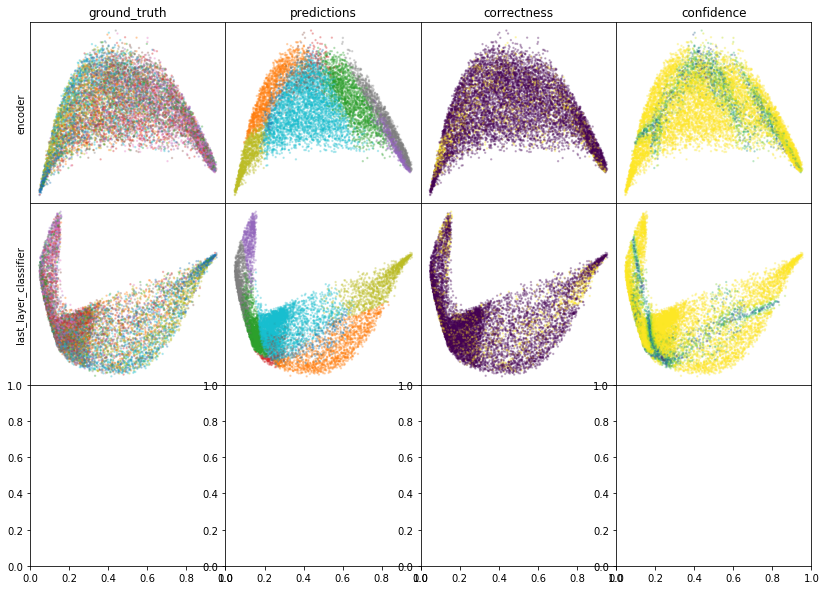

W0806 23:15:11.399623 139770049615616 legend.py:1282] No handles with labels found to put in legend.
W0806 23:15:11.497099 139770049615616 legend.py:1282] No handles with labels found to put in legend.
W0806 23:15:11.596607 139770049615616 legend.py:1282] No handles with labels found to put in legend.


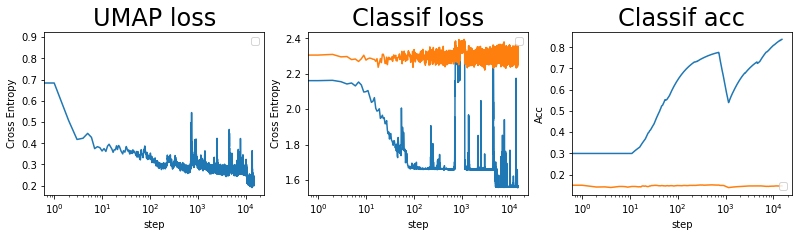

batch: 15000 | train acc: 0.8373 | val acc: 0.1472


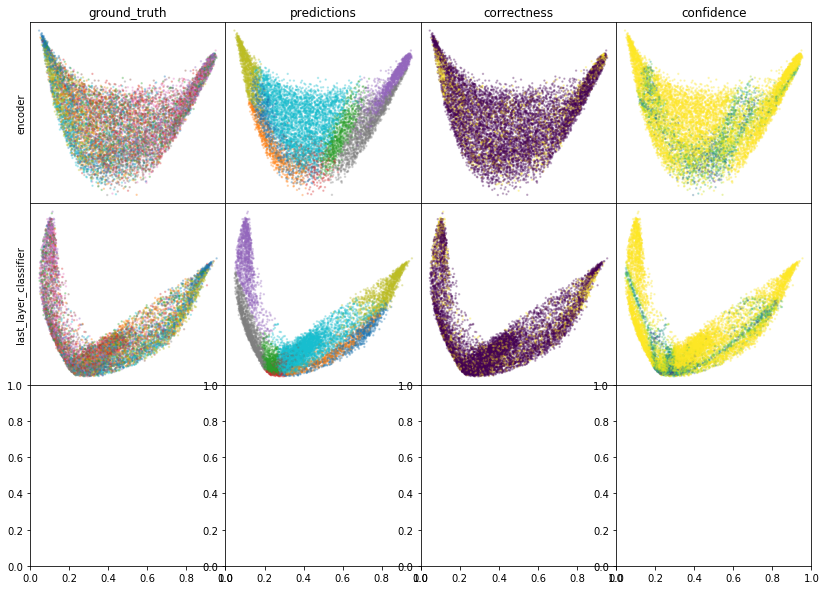

W0806 23:20:54.834147 139770049615616 legend.py:1282] No handles with labels found to put in legend.
W0806 23:20:54.928917 139770049615616 legend.py:1282] No handles with labels found to put in legend.
W0806 23:20:55.023007 139770049615616 legend.py:1282] No handles with labels found to put in legend.


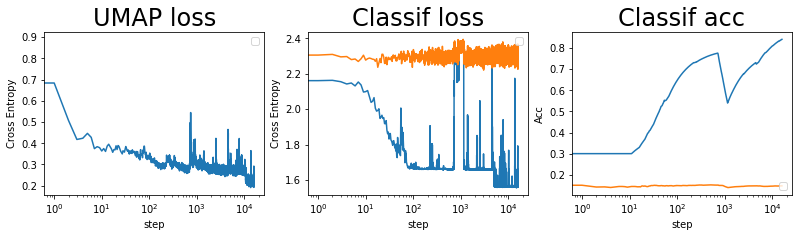

batch: 16000 | train acc: 0.8412 | val acc: 0.1475


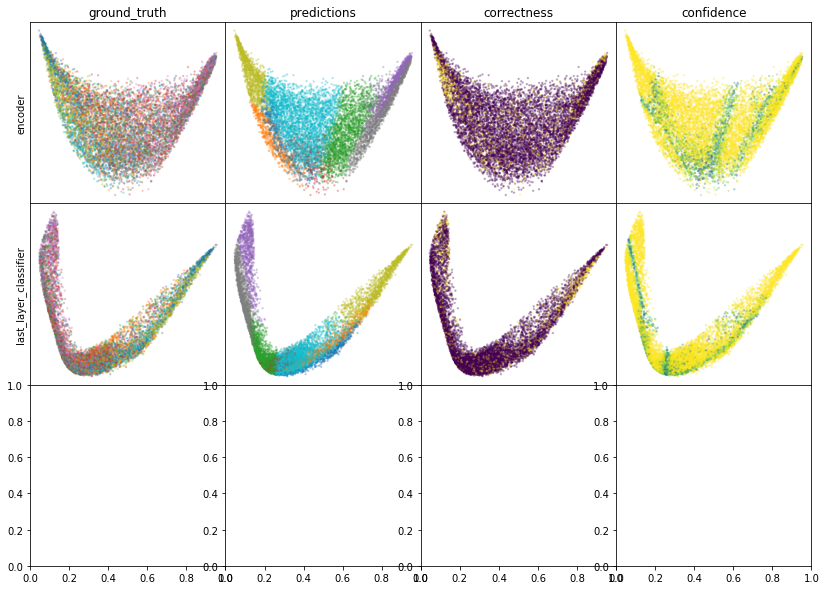

W0806 23:27:18.746494 139770049615616 legend.py:1282] No handles with labels found to put in legend.
W0806 23:27:18.849906 139770049615616 legend.py:1282] No handles with labels found to put in legend.
W0806 23:27:18.953549 139770049615616 legend.py:1282] No handles with labels found to put in legend.


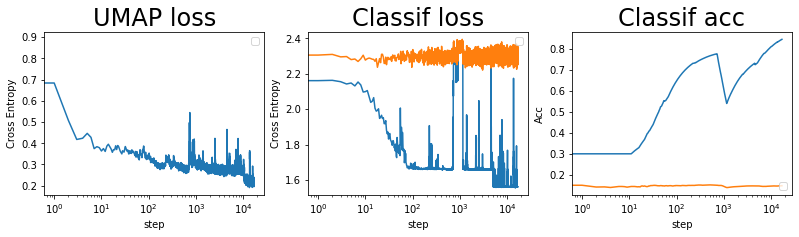

batch: 17000 | train acc: 0.8446 | val acc: 0.1481


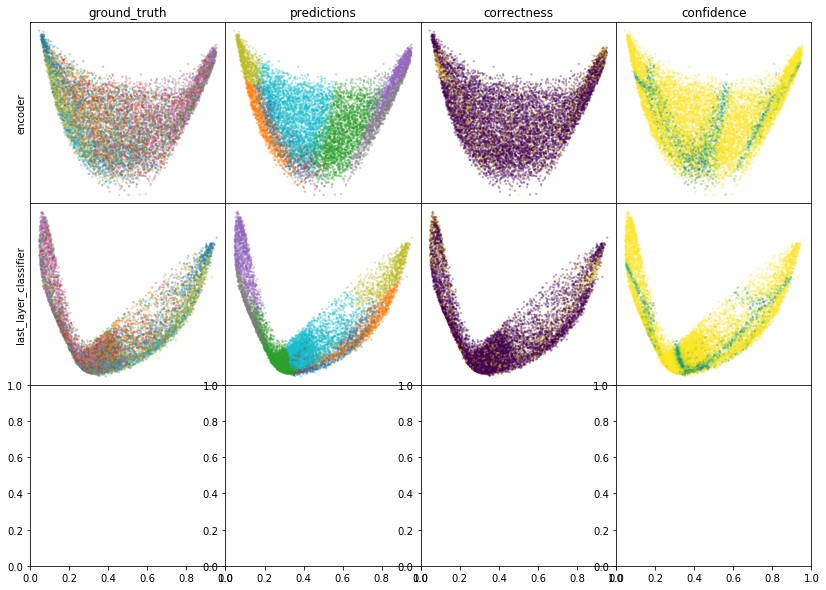

W0806 23:34:26.582204 139770049615616 legend.py:1282] No handles with labels found to put in legend.
W0806 23:34:26.687639 139770049615616 legend.py:1282] No handles with labels found to put in legend.
W0806 23:34:26.798339 139770049615616 legend.py:1282] No handles with labels found to put in legend.


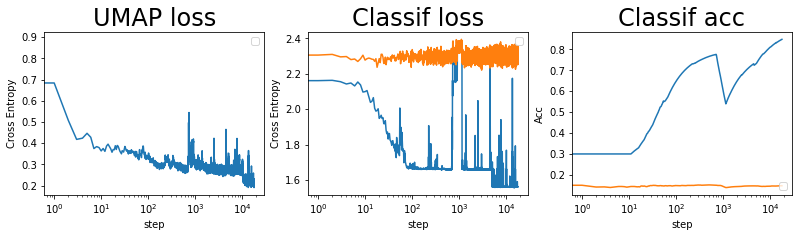

batch: 18000 | train acc: 0.8477 | val acc: 0.148


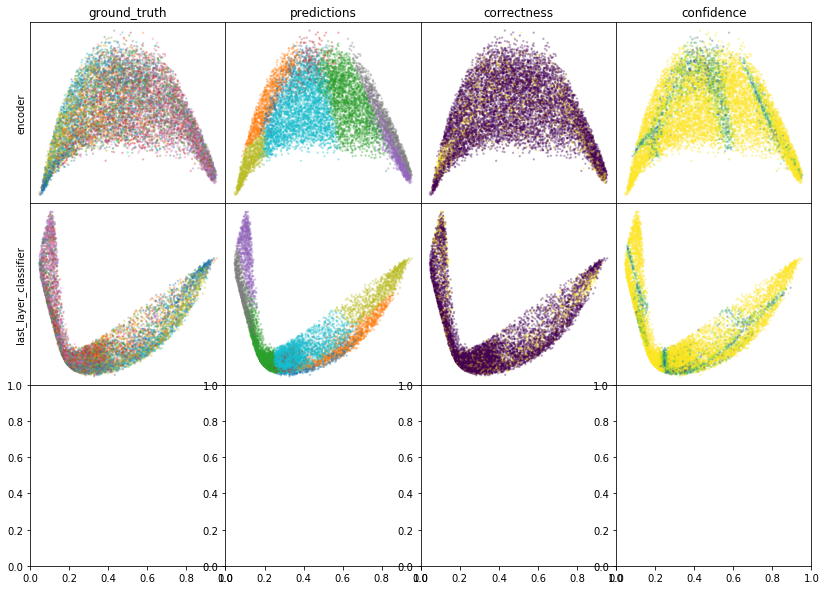

W0806 23:46:13.459170 139770049615616 legend.py:1282] No handles with labels found to put in legend.
W0806 23:46:13.565371 139770049615616 legend.py:1282] No handles with labels found to put in legend.
W0806 23:46:13.680677 139770049615616 legend.py:1282] No handles with labels found to put in legend.


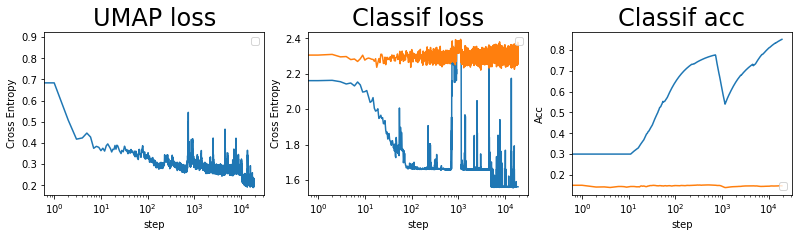

batch: 19000 | train acc: 0.8504 | val acc: 0.1478


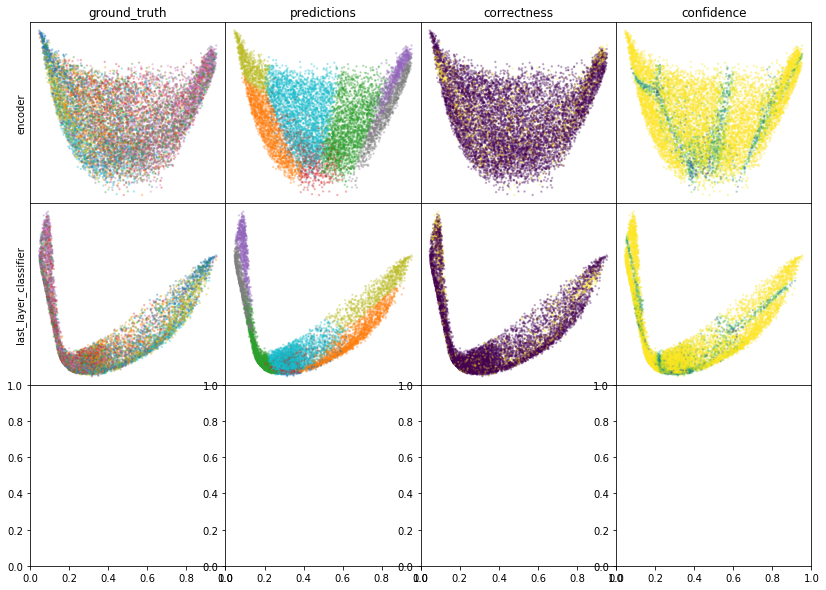

W0806 23:57:25.269265 139770049615616 legend.py:1282] No handles with labels found to put in legend.
W0806 23:57:25.383320 139770049615616 legend.py:1282] No handles with labels found to put in legend.
W0806 23:57:25.492506 139770049615616 legend.py:1282] No handles with labels found to put in legend.


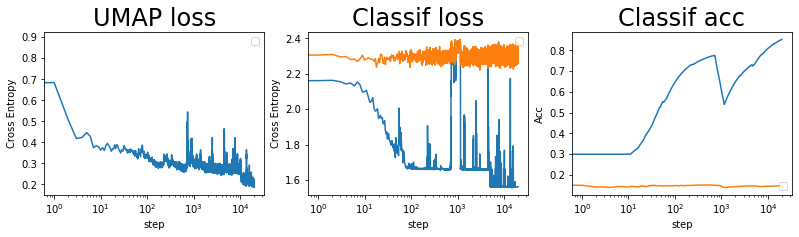

batch: 20000 | train acc: 0.8529 | val acc: 0.1473
leaving epoch because no improvement in 10000 batches


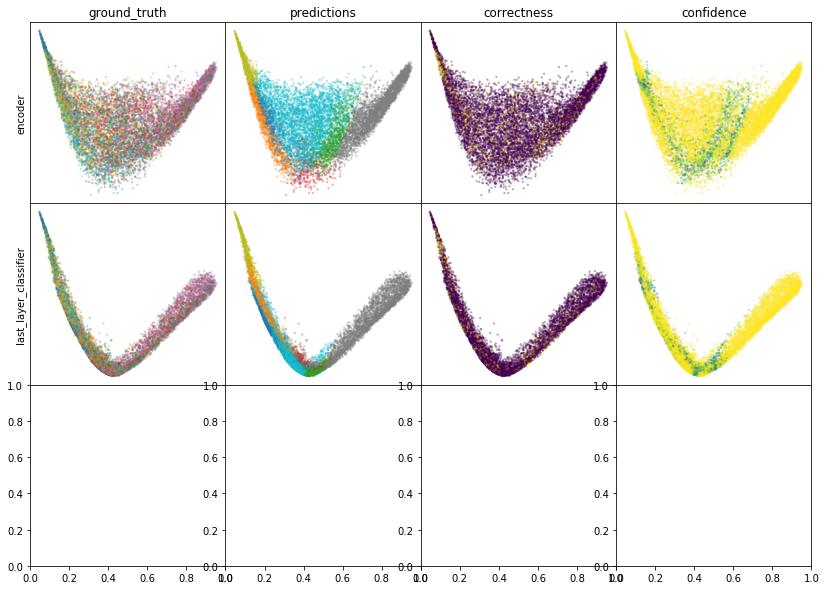

W0807 00:10:12.564380 139770049615616 legend.py:1282] No handles with labels found to put in legend.
W0807 00:10:12.682446 139770049615616 legend.py:1282] No handles with labels found to put in legend.
W0807 00:10:12.795066 139770049615616 legend.py:1282] No handles with labels found to put in legend.


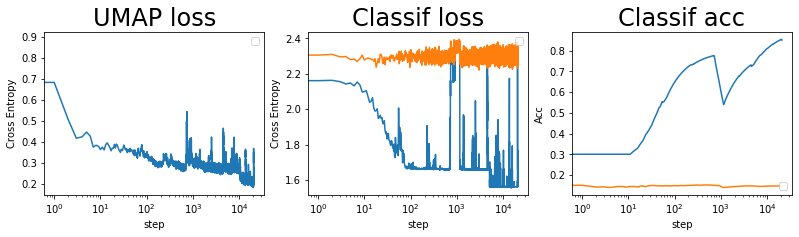

batch: 21000 | train acc: 0.8505 | val acc: 0.1471


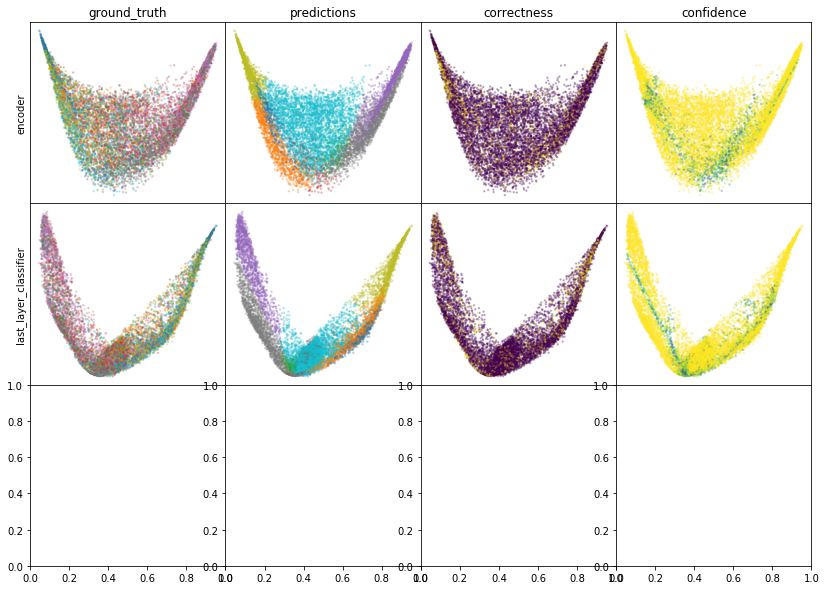

W0807 00:21:25.742104 139770049615616 legend.py:1282] No handles with labels found to put in legend.
W0807 00:21:25.872919 139770049615616 legend.py:1282] No handles with labels found to put in legend.
W0807 00:21:25.992280 139770049615616 legend.py:1282] No handles with labels found to put in legend.


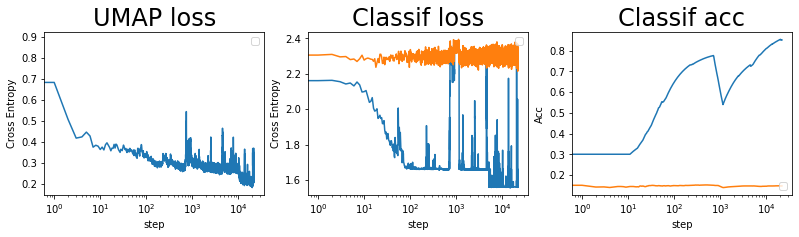

batch: 22000 | train acc: 0.8509 | val acc: 0.1475


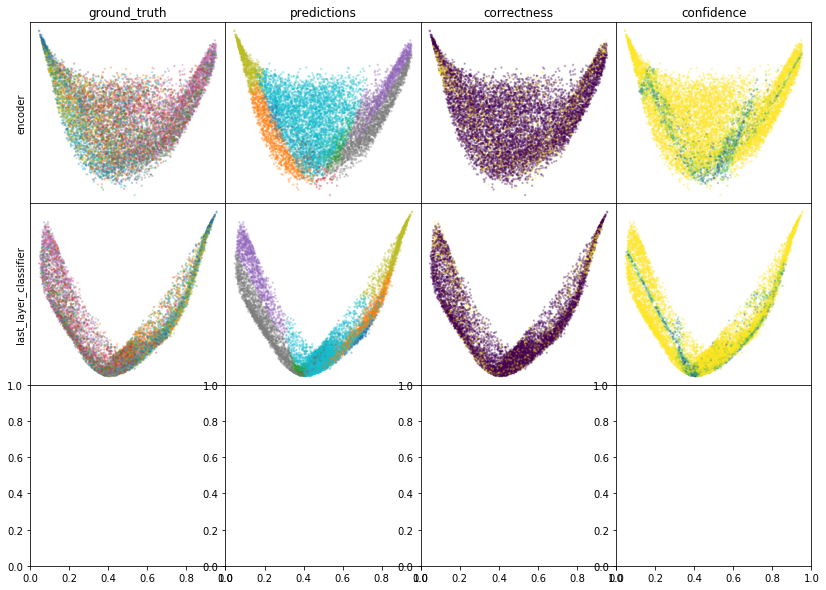

W0807 00:33:14.800006 139770049615616 legend.py:1282] No handles with labels found to put in legend.
W0807 00:33:14.922833 139770049615616 legend.py:1282] No handles with labels found to put in legend.
W0807 00:33:15.049032 139770049615616 legend.py:1282] No handles with labels found to put in legend.


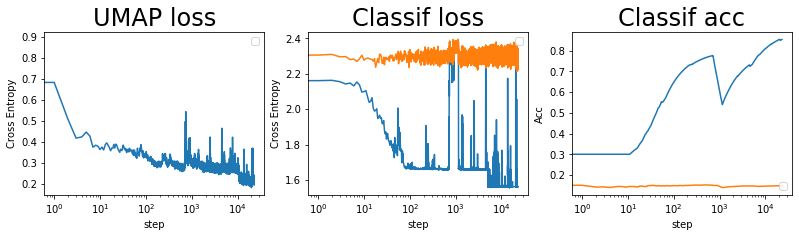

batch: 23000 | train acc: 0.8531 | val acc: 0.1482


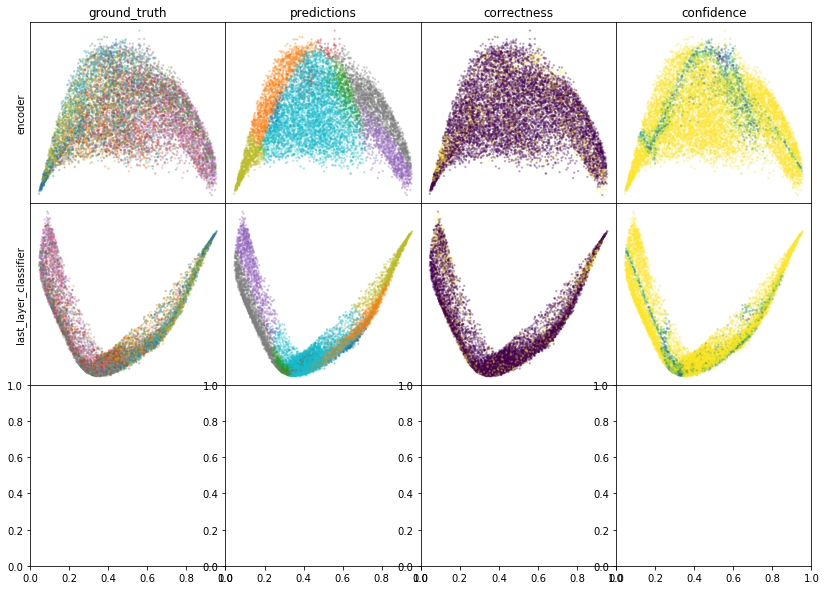

W0807 00:44:36.960697 139770049615616 legend.py:1282] No handles with labels found to put in legend.
W0807 00:44:37.081695 139770049615616 legend.py:1282] No handles with labels found to put in legend.
W0807 00:44:37.207610 139770049615616 legend.py:1282] No handles with labels found to put in legend.


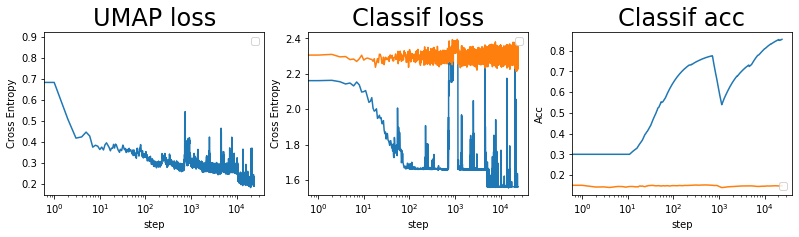

batch: 24000 | train acc: 0.855 | val acc: 0.1486


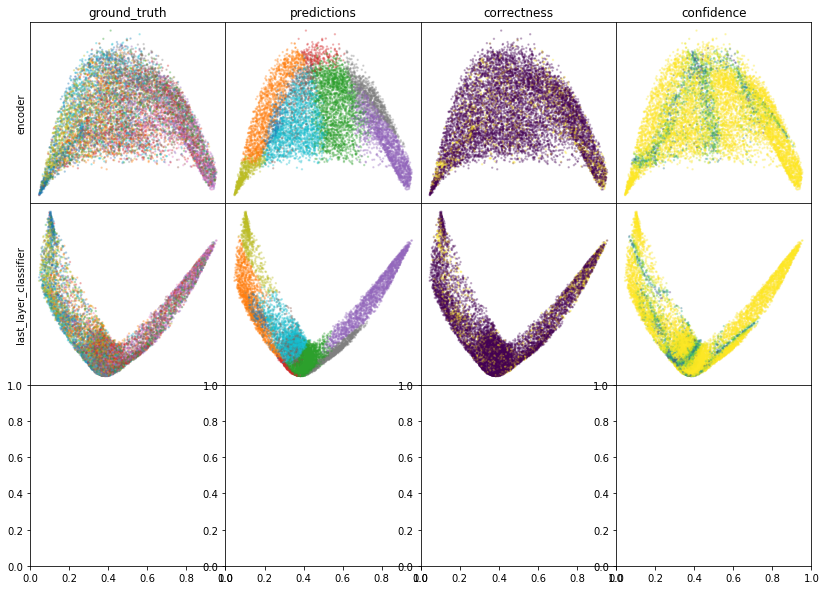

W0807 00:56:25.720695 139770049615616 legend.py:1282] No handles with labels found to put in legend.
W0807 00:56:25.848273 139770049615616 legend.py:1282] No handles with labels found to put in legend.
W0807 00:56:25.977962 139770049615616 legend.py:1282] No handles with labels found to put in legend.


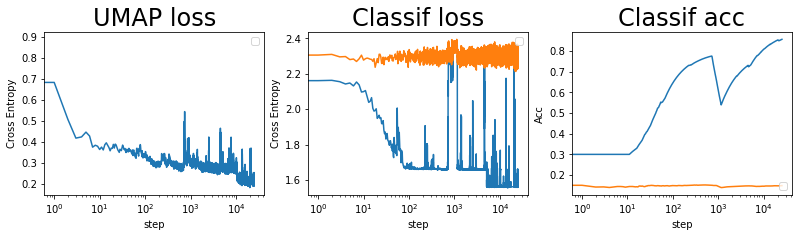

batch: 25000 | train acc: 0.8567 | val acc: 0.1487


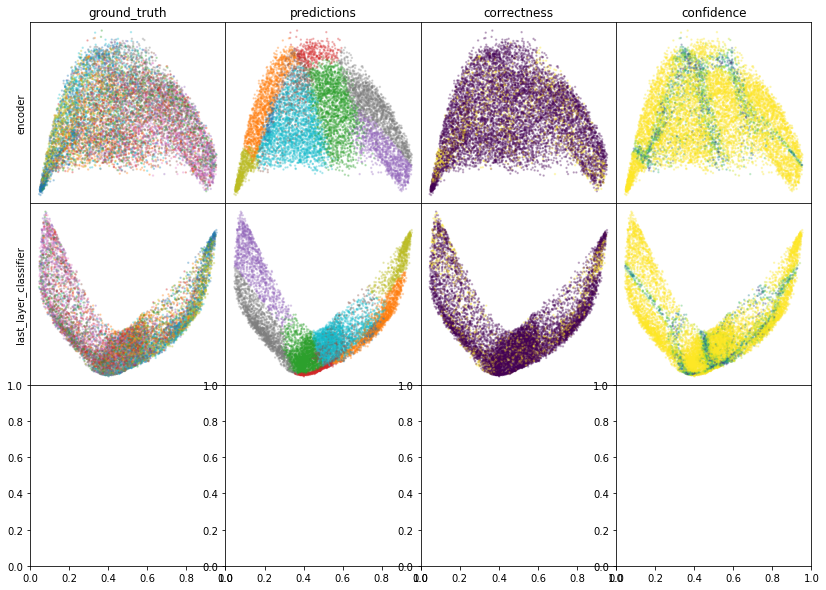

W0807 01:07:38.437316 139770049615616 legend.py:1282] No handles with labels found to put in legend.
W0807 01:07:38.568416 139770049615616 legend.py:1282] No handles with labels found to put in legend.
W0807 01:07:38.704731 139770049615616 legend.py:1282] No handles with labels found to put in legend.


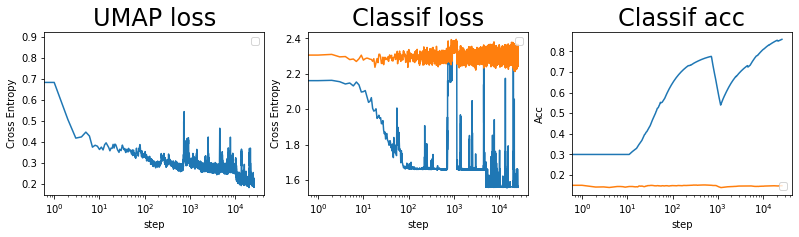

batch: 26000 | train acc: 0.8583 | val acc: 0.1485


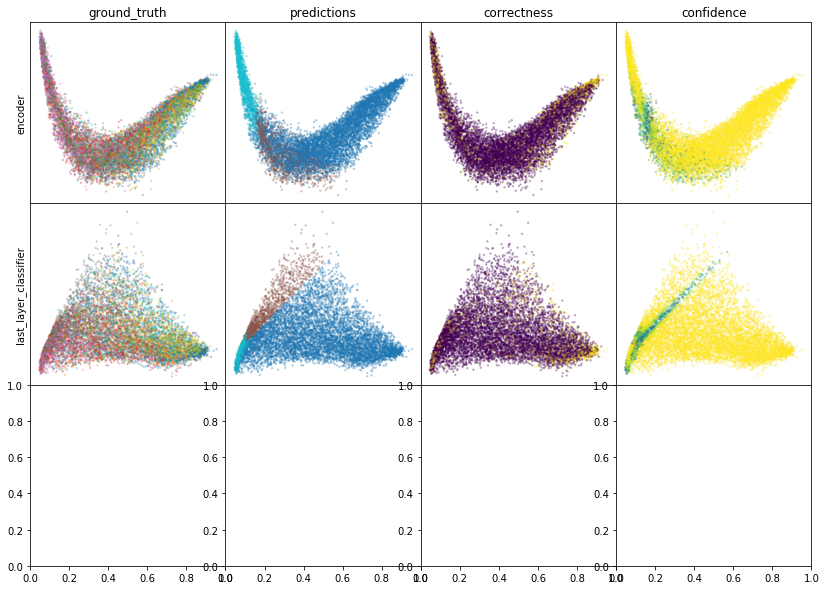

W0807 01:19:27.403588 139770049615616 legend.py:1282] No handles with labels found to put in legend.
W0807 01:19:27.538831 139770049615616 legend.py:1282] No handles with labels found to put in legend.
W0807 01:19:27.674515 139770049615616 legend.py:1282] No handles with labels found to put in legend.


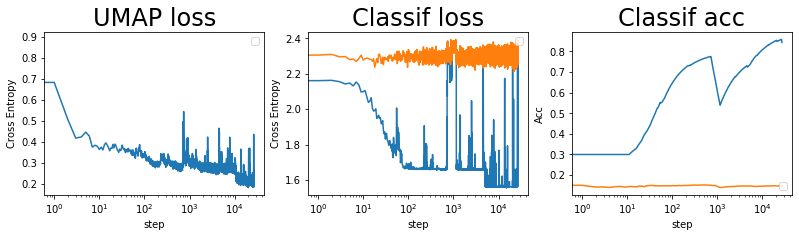

batch: 27000 | train acc: 0.8441 | val acc: 0.1477


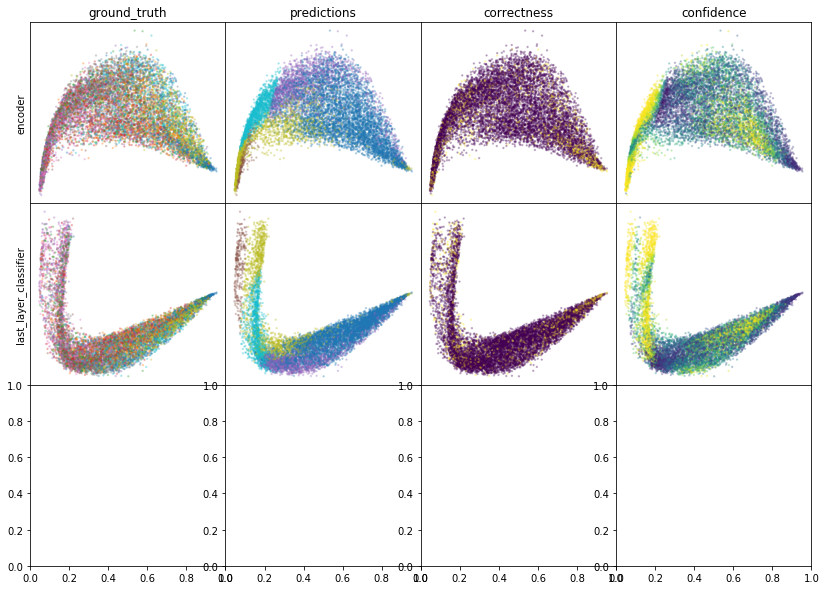

W0807 01:30:39.446444 139770049615616 legend.py:1282] No handles with labels found to put in legend.
W0807 01:30:39.587157 139770049615616 legend.py:1282] No handles with labels found to put in legend.
W0807 01:30:39.725781 139770049615616 legend.py:1282] No handles with labels found to put in legend.


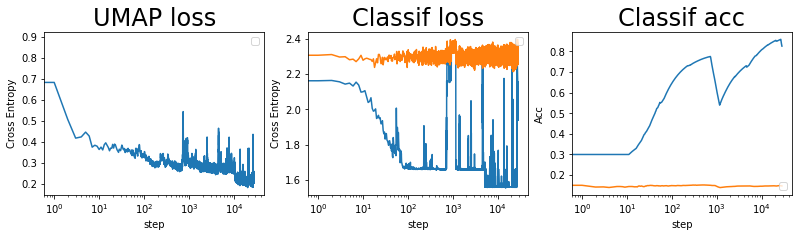

batch: 28000 | train acc: 0.826 | val acc: 0.1474


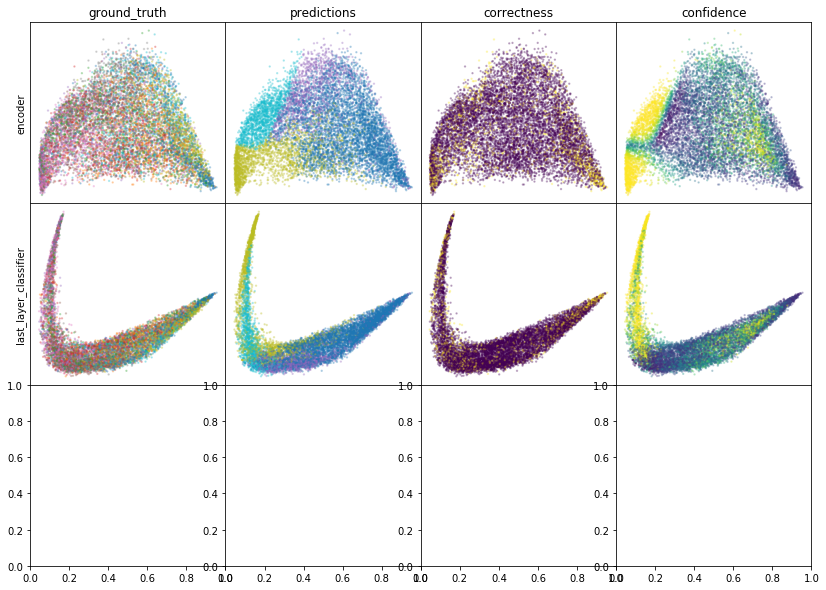

W0807 01:42:28.796405 139770049615616 legend.py:1282] No handles with labels found to put in legend.
W0807 01:42:28.949136 139770049615616 legend.py:1282] No handles with labels found to put in legend.
W0807 01:42:29.102907 139770049615616 legend.py:1282] No handles with labels found to put in legend.


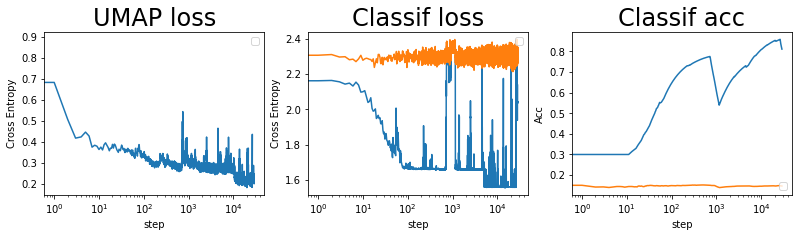

batch: 29000 | train acc: 0.8115 | val acc: 0.147


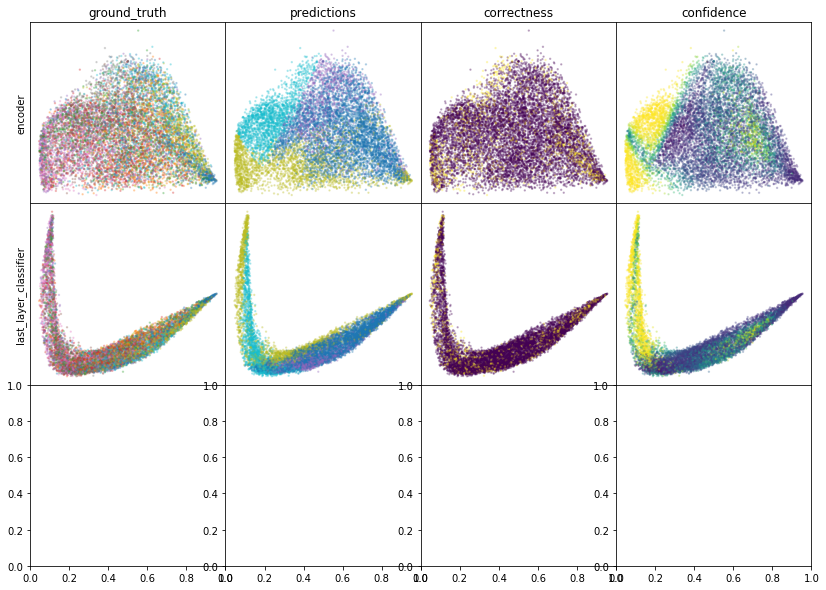

W0807 01:53:41.953286 139770049615616 legend.py:1282] No handles with labels found to put in legend.
W0807 01:53:42.099164 139770049615616 legend.py:1282] No handles with labels found to put in legend.
W0807 01:53:42.249509 139770049615616 legend.py:1282] No handles with labels found to put in legend.


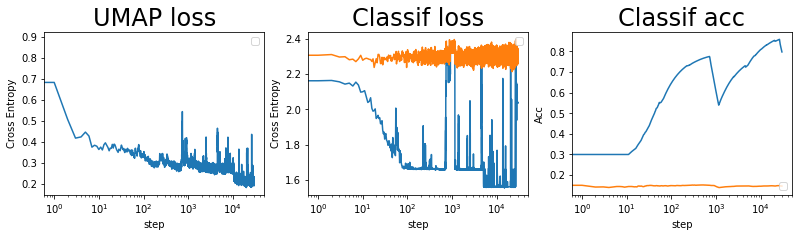

batch: 30000 | train acc: 0.7978 | val acc: 0.1467
leaving epoch because no improvement in 10000 batches


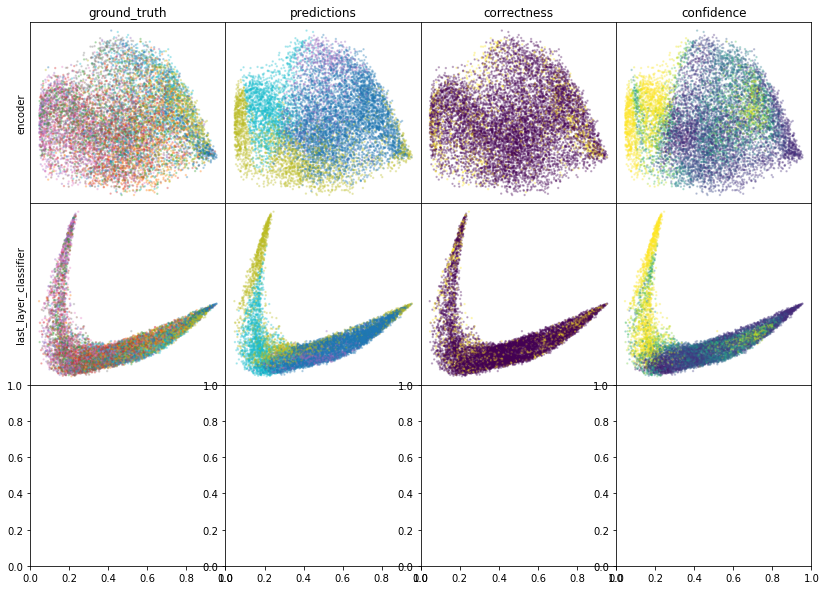

W0807 02:06:32.041408 139770049615616 legend.py:1282] No handles with labels found to put in legend.
W0807 02:06:32.200770 139770049615616 legend.py:1282] No handles with labels found to put in legend.
W0807 02:06:32.362285 139770049615616 legend.py:1282] No handles with labels found to put in legend.


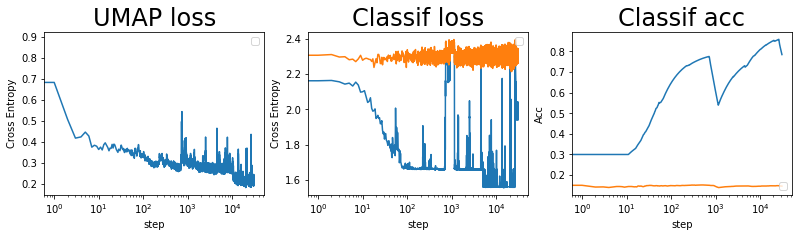

batch: 31000 | train acc: 0.785 | val acc: 0.1464


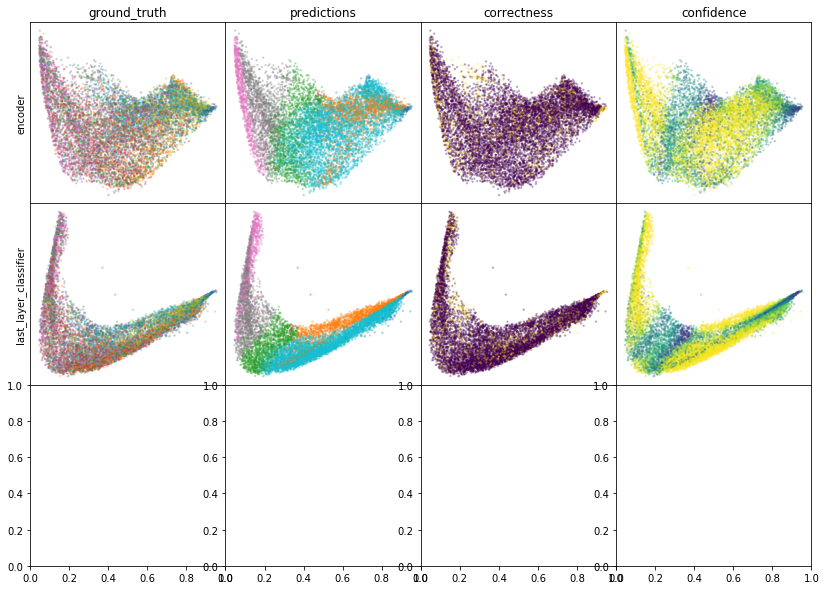

W0807 02:17:45.604087 139770049615616 legend.py:1282] No handles with labels found to put in legend.
W0807 02:17:45.747458 139770049615616 legend.py:1282] No handles with labels found to put in legend.
W0807 02:17:45.898130 139770049615616 legend.py:1282] No handles with labels found to put in legend.


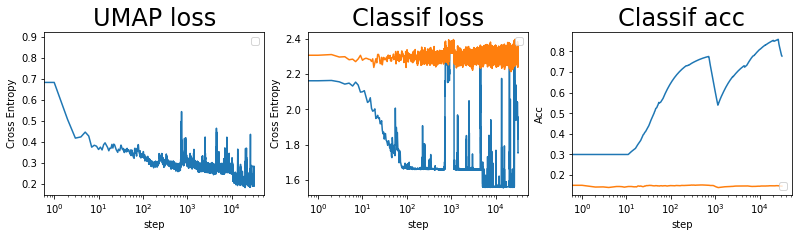

batch: 32000 | train acc: 0.7775 | val acc: 0.1464


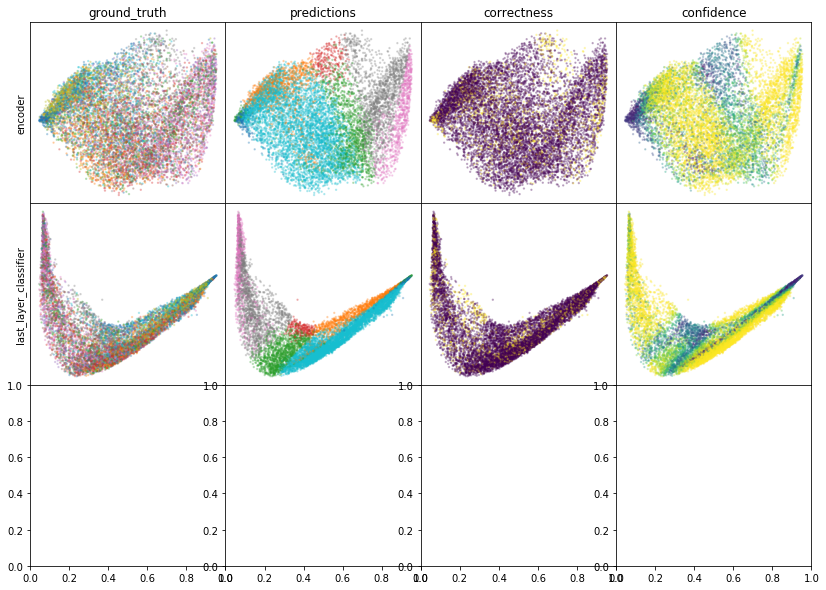

W0807 02:29:33.672395 139770049615616 legend.py:1282] No handles with labels found to put in legend.
W0807 02:29:33.825733 139770049615616 legend.py:1282] No handles with labels found to put in legend.
W0807 02:29:33.977841 139770049615616 legend.py:1282] No handles with labels found to put in legend.


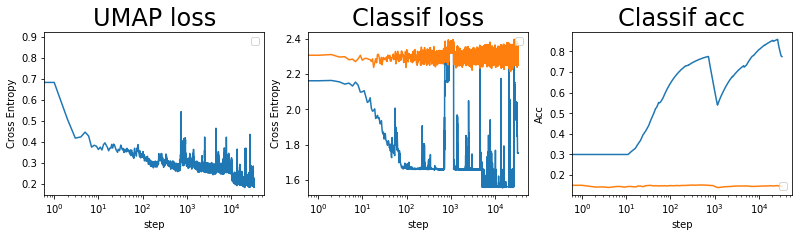

batch: 33000 | train acc: 0.7752 | val acc: 0.1462


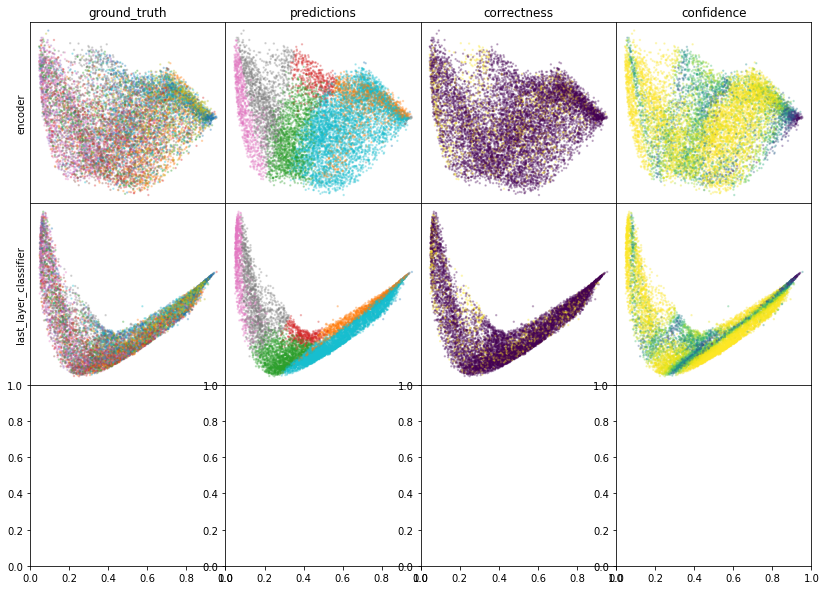

W0807 02:40:46.949468 139770049615616 legend.py:1282] No handles with labels found to put in legend.
W0807 02:40:47.099911 139770049615616 legend.py:1282] No handles with labels found to put in legend.
W0807 02:40:47.255017 139770049615616 legend.py:1282] No handles with labels found to put in legend.


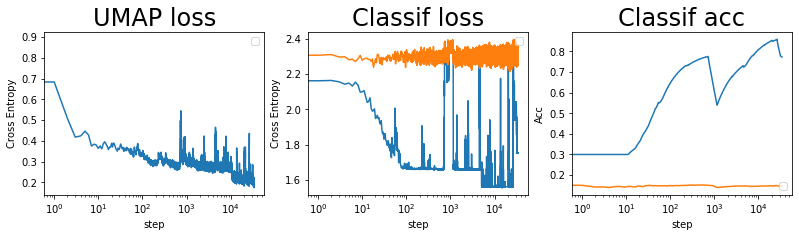

batch: 34000 | train acc: 0.773 | val acc: 0.1461


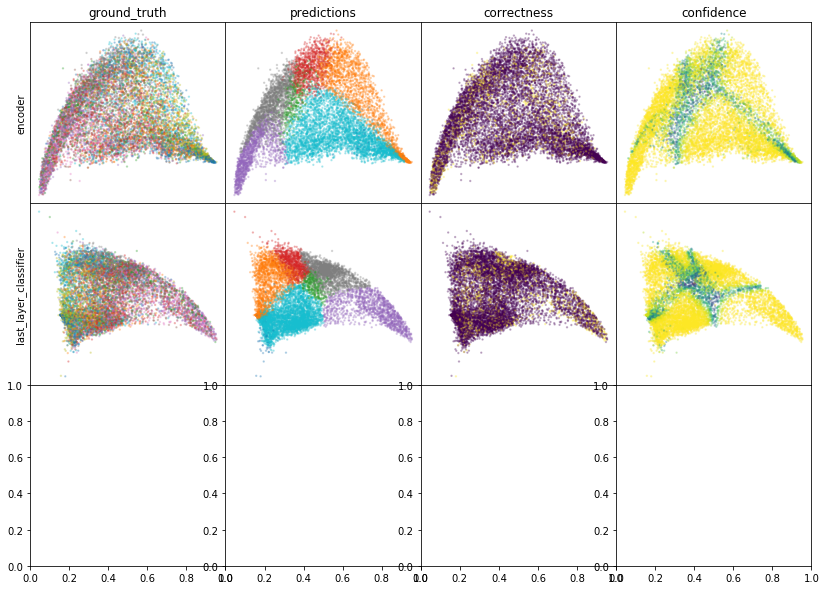

W0807 02:52:48.877160 139770049615616 legend.py:1282] No handles with labels found to put in legend.
W0807 02:52:49.041199 139770049615616 legend.py:1282] No handles with labels found to put in legend.
W0807 02:52:49.204645 139770049615616 legend.py:1282] No handles with labels found to put in legend.


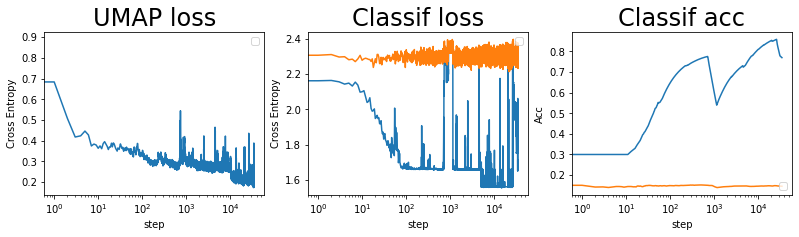

batch: 35000 | train acc: 0.7701 | val acc: 0.1458


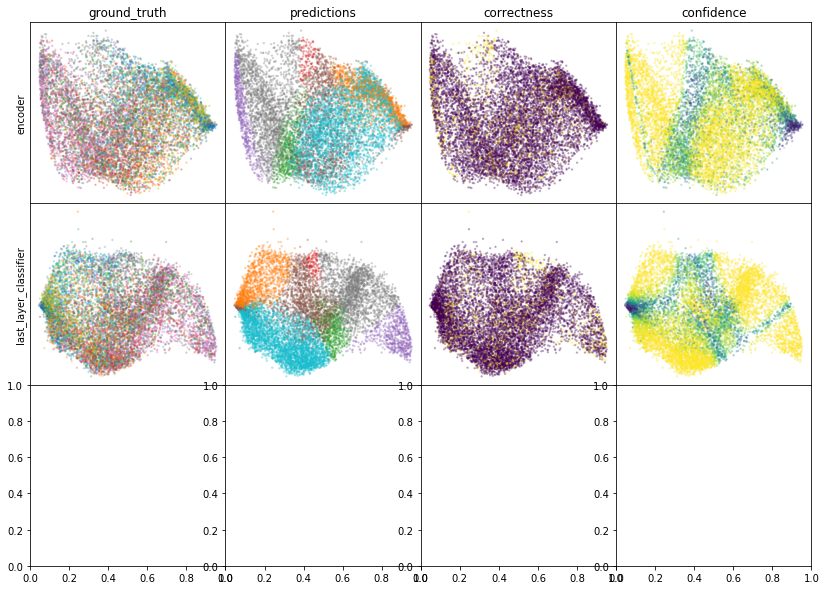

W0807 03:04:02.542228 139770049615616 legend.py:1282] No handles with labels found to put in legend.
W0807 03:04:02.703722 139770049615616 legend.py:1282] No handles with labels found to put in legend.
W0807 03:04:02.868566 139770049615616 legend.py:1282] No handles with labels found to put in legend.


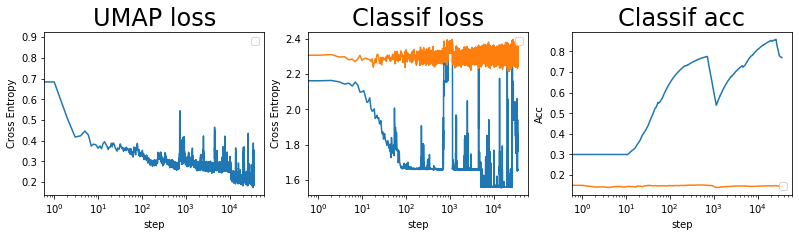

batch: 36000 | train acc: 0.7701 | val acc: 0.1456


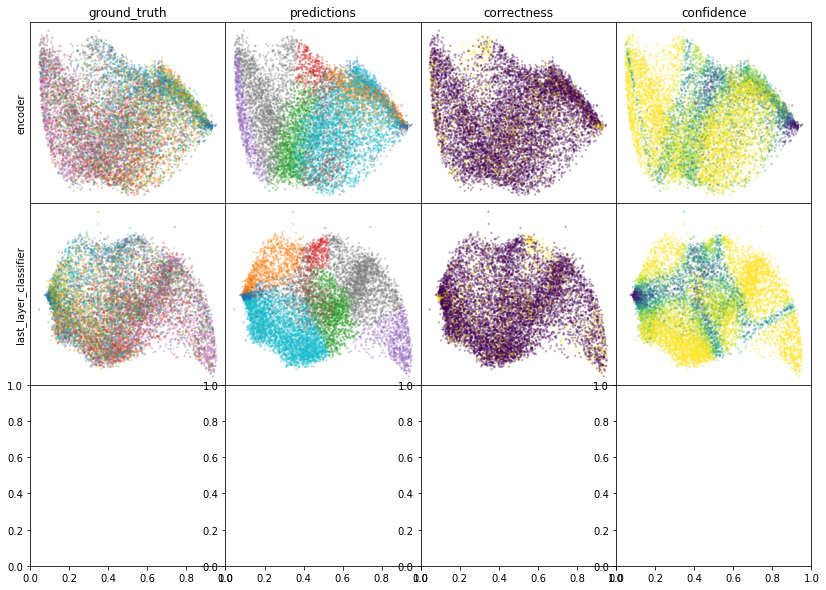

W0807 03:15:51.166568 139770049615616 legend.py:1282] No handles with labels found to put in legend.
W0807 03:15:51.332070 139770049615616 legend.py:1282] No handles with labels found to put in legend.
W0807 03:15:51.493437 139770049615616 legend.py:1282] No handles with labels found to put in legend.


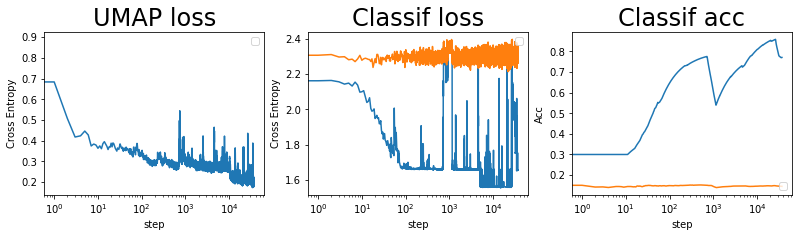

batch: 37000 | train acc: 0.7709 | val acc: 0.1453


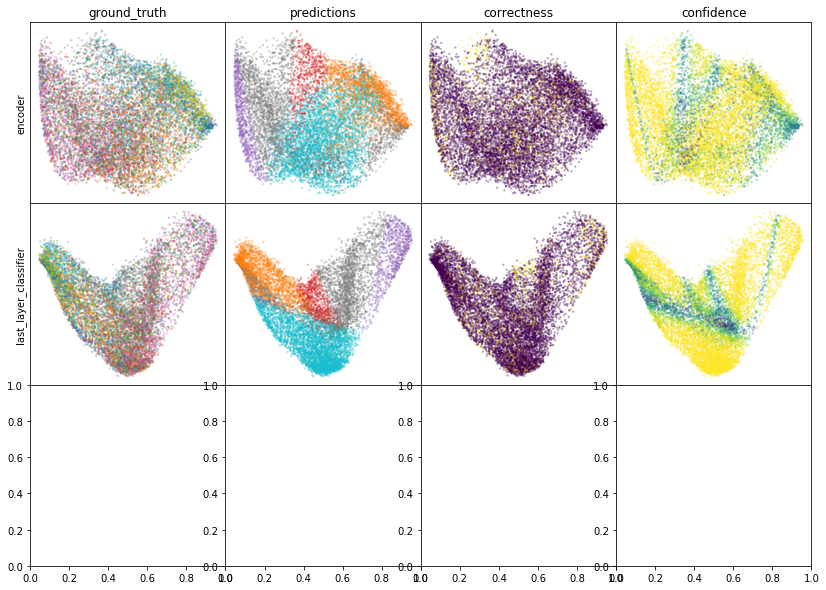

W0807 03:27:05.489539 139770049615616 legend.py:1282] No handles with labels found to put in legend.
W0807 03:27:05.656991 139770049615616 legend.py:1282] No handles with labels found to put in legend.
W0807 03:27:05.820010 139770049615616 legend.py:1282] No handles with labels found to put in legend.


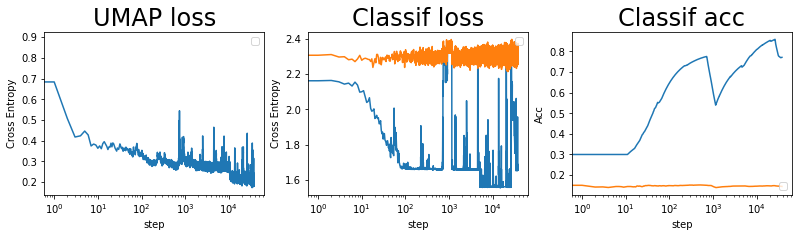

batch: 38000 | train acc: 0.7715 | val acc: 0.145


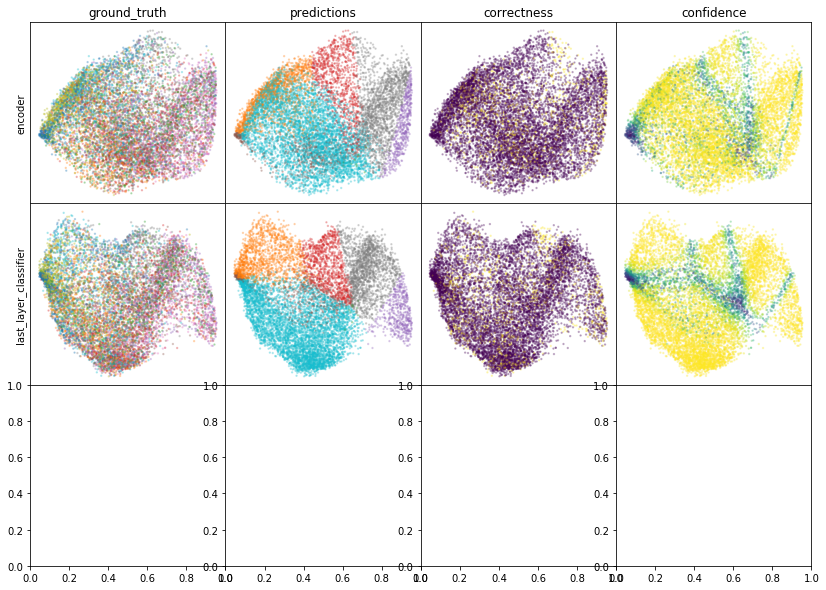

W0807 03:38:53.721940 139770049615616 legend.py:1282] No handles with labels found to put in legend.
W0807 03:38:53.889623 139770049615616 legend.py:1282] No handles with labels found to put in legend.
W0807 03:38:54.058746 139770049615616 legend.py:1282] No handles with labels found to put in legend.


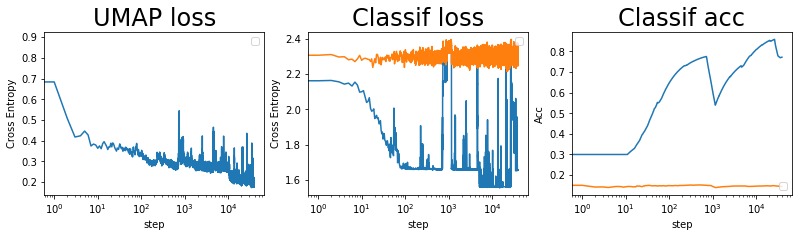

batch: 39000 | train acc: 0.7722 | val acc: 0.1445


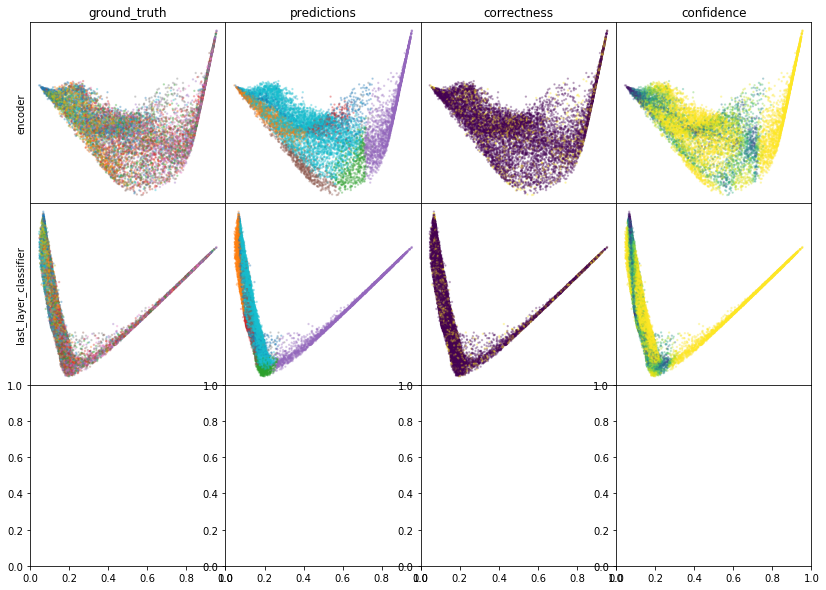

W0807 03:50:21.890542 139770049615616 legend.py:1282] No handles with labels found to put in legend.
W0807 03:50:22.064432 139770049615616 legend.py:1282] No handles with labels found to put in legend.
W0807 03:50:22.237006 139770049615616 legend.py:1282] No handles with labels found to put in legend.


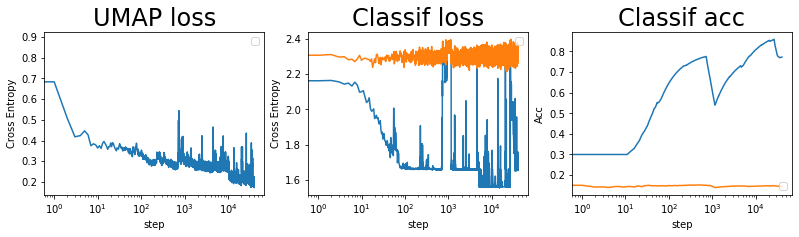

batch: 40000 | train acc: 0.7729 | val acc: 0.144
leaving epoch because no improvement in 10000 batches


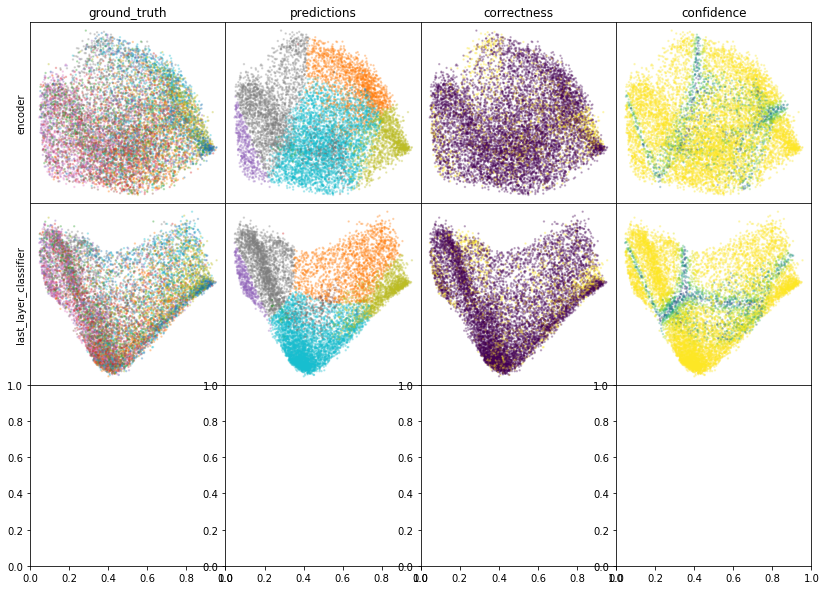

W0807 04:03:00.179939 139770049615616 legend.py:1282] No handles with labels found to put in legend.
W0807 04:03:00.354763 139770049615616 legend.py:1282] No handles with labels found to put in legend.
W0807 04:03:00.529111 139770049615616 legend.py:1282] No handles with labels found to put in legend.


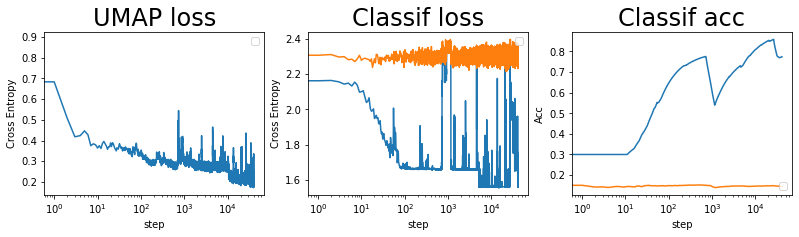

batch: 41000 | train acc: 0.7744 | val acc: 0.1442


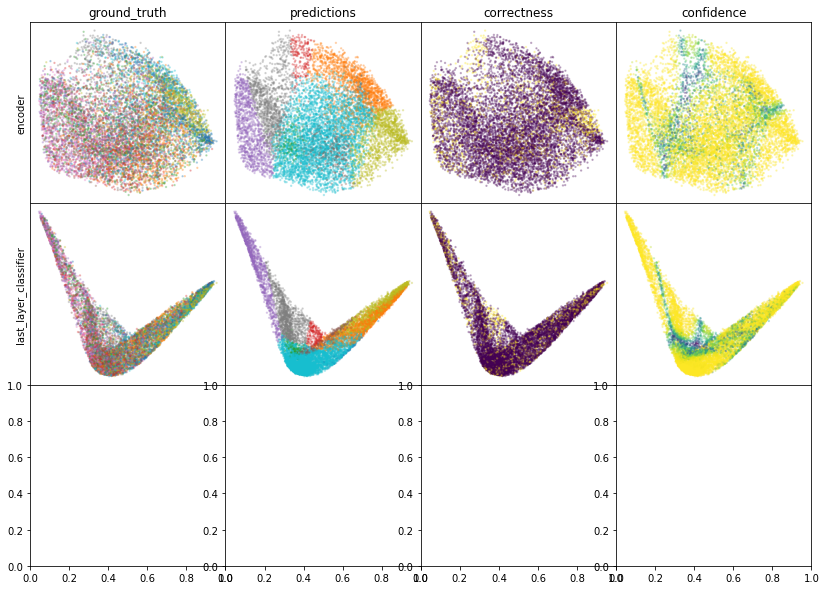

W0807 04:14:30.252823 139770049615616 legend.py:1282] No handles with labels found to put in legend.
W0807 04:14:30.430280 139770049615616 legend.py:1282] No handles with labels found to put in legend.
W0807 04:14:30.609221 139770049615616 legend.py:1282] No handles with labels found to put in legend.


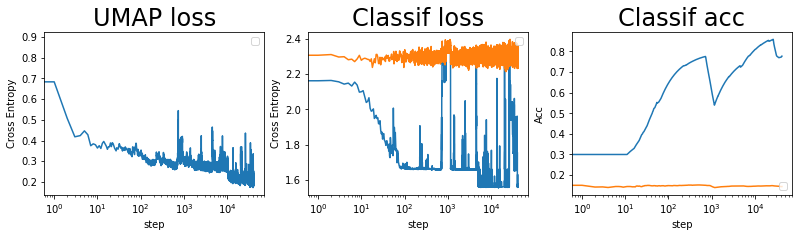

batch: 42000 | train acc: 0.7774 | val acc: 0.1444


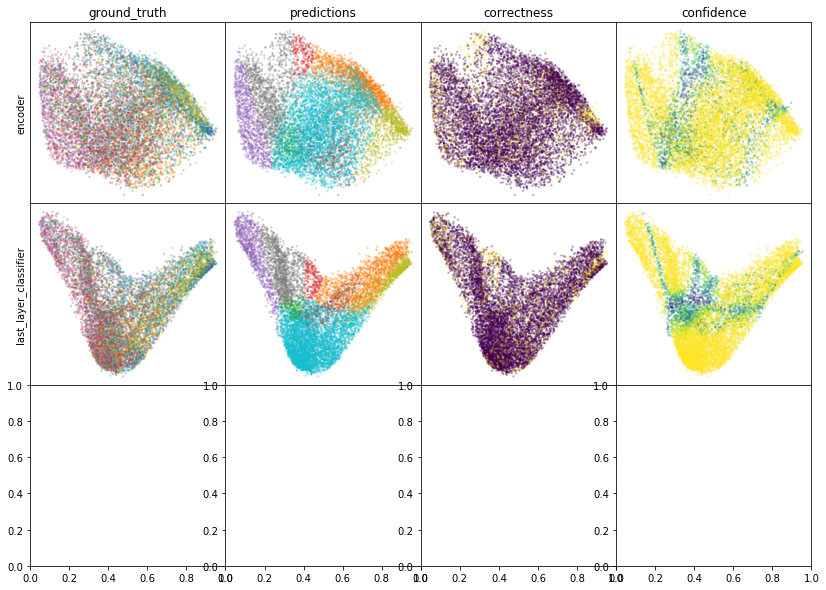

W0807 04:26:20.831494 139770049615616 legend.py:1282] No handles with labels found to put in legend.
W0807 04:26:21.023436 139770049615616 legend.py:1282] No handles with labels found to put in legend.
W0807 04:26:21.210957 139770049615616 legend.py:1282] No handles with labels found to put in legend.


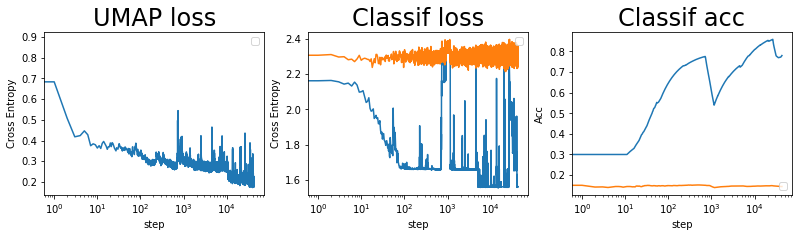

batch: 43000 | train acc: 0.7802 | val acc: 0.1446


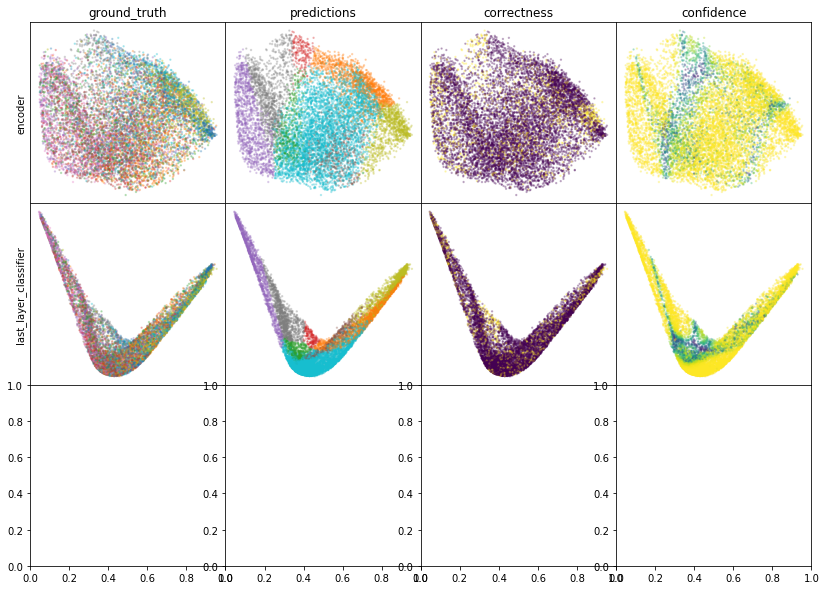

W0807 04:37:33.894161 139770049615616 legend.py:1282] No handles with labels found to put in legend.
W0807 04:37:34.088802 139770049615616 legend.py:1282] No handles with labels found to put in legend.
W0807 04:37:34.279711 139770049615616 legend.py:1282] No handles with labels found to put in legend.


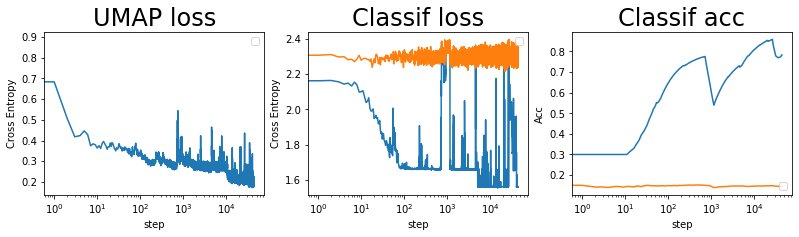

batch: 44000 | train acc: 0.7829 | val acc: 0.1448


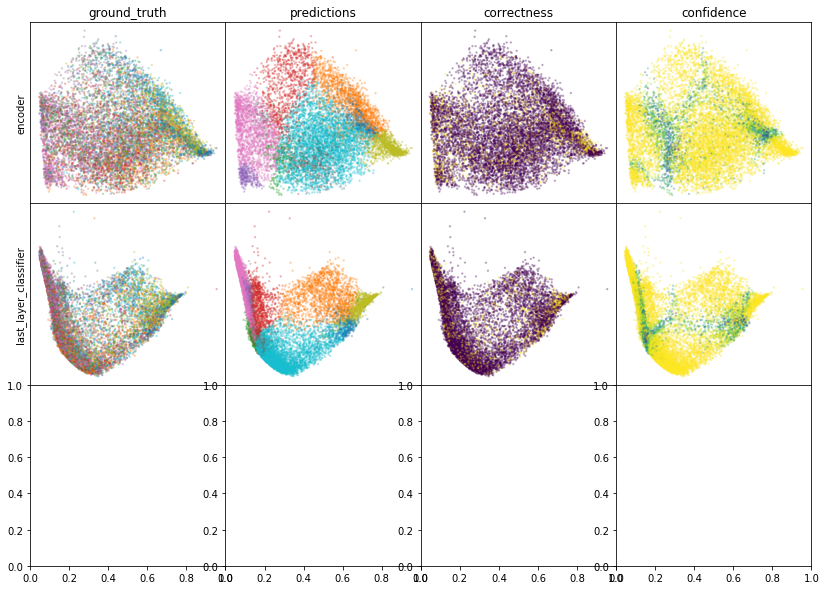

W0807 04:49:22.057515 139770049615616 legend.py:1282] No handles with labels found to put in legend.
W0807 04:49:22.240971 139770049615616 legend.py:1282] No handles with labels found to put in legend.
W0807 04:49:22.434675 139770049615616 legend.py:1282] No handles with labels found to put in legend.


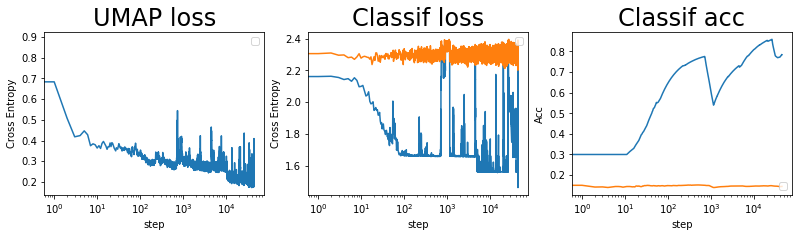

batch: 45000 | train acc: 0.7844 | val acc: 0.145


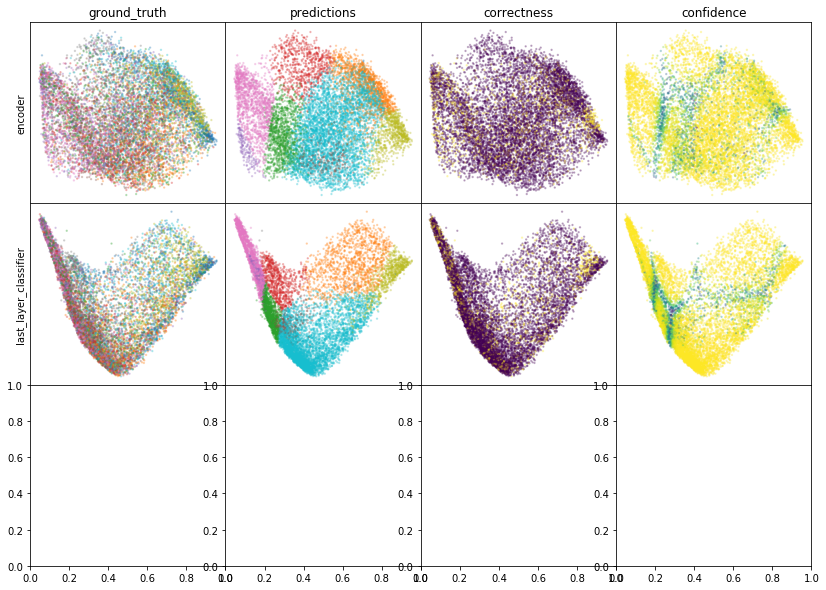

W0807 05:00:36.610512 139770049615616 legend.py:1282] No handles with labels found to put in legend.
W0807 05:00:36.794762 139770049615616 legend.py:1282] No handles with labels found to put in legend.
W0807 05:00:36.999266 139770049615616 legend.py:1282] No handles with labels found to put in legend.


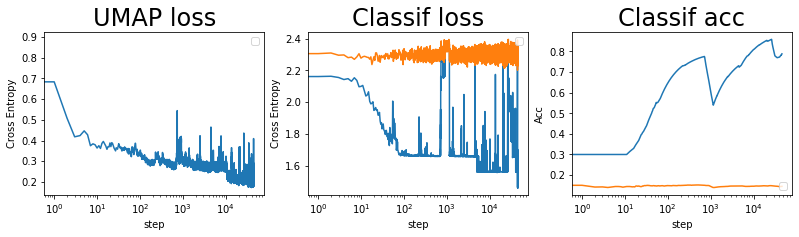

batch: 46000 | train acc: 0.7885 | val acc: 0.1453


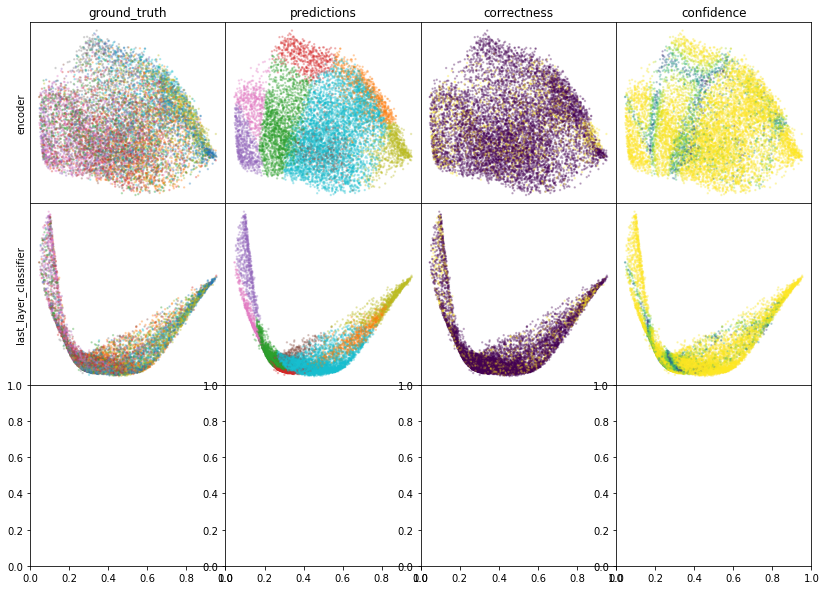

W0807 05:12:24.298669 139770049615616 legend.py:1282] No handles with labels found to put in legend.
W0807 05:12:24.486446 139770049615616 legend.py:1282] No handles with labels found to put in legend.
W0807 05:12:24.675508 139770049615616 legend.py:1282] No handles with labels found to put in legend.


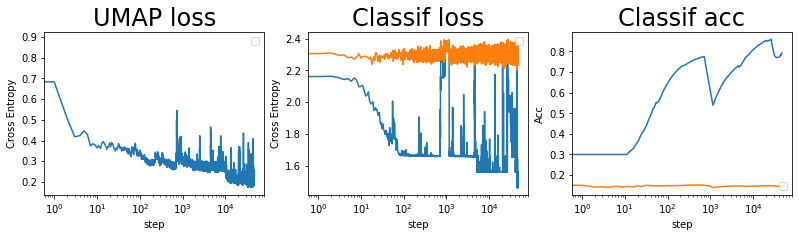

batch: 47000 | train acc: 0.7926 | val acc: 0.1454


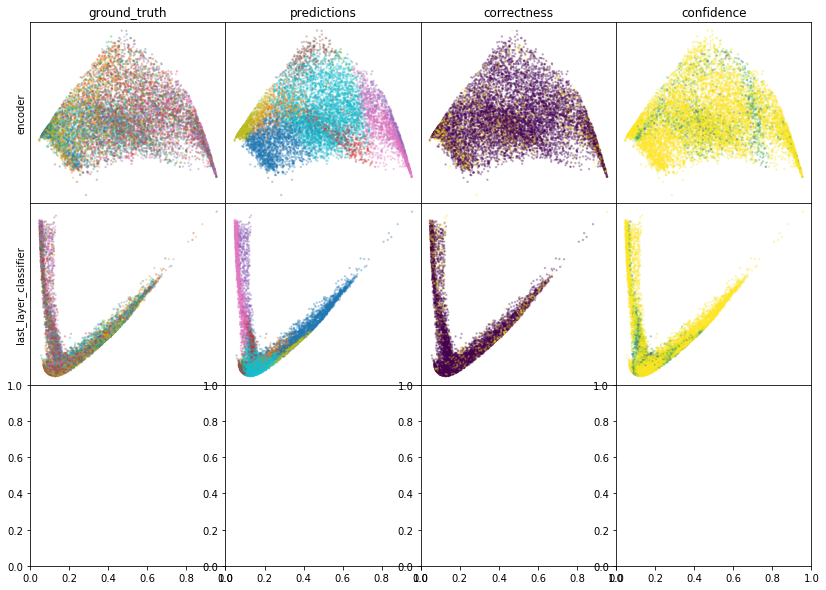

W0807 05:23:36.884794 139770049615616 legend.py:1282] No handles with labels found to put in legend.
W0807 05:23:37.093410 139770049615616 legend.py:1282] No handles with labels found to put in legend.
W0807 05:23:37.312496 139770049615616 legend.py:1282] No handles with labels found to put in legend.


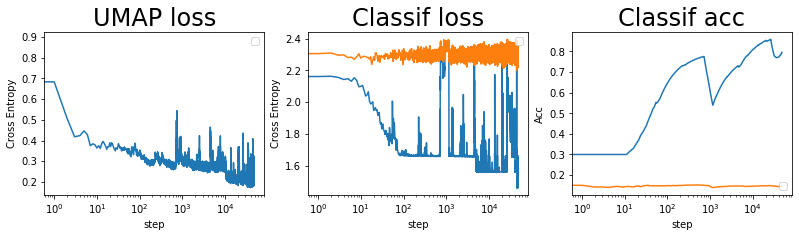

batch: 48000 | train acc: 0.7959 | val acc: 0.1458


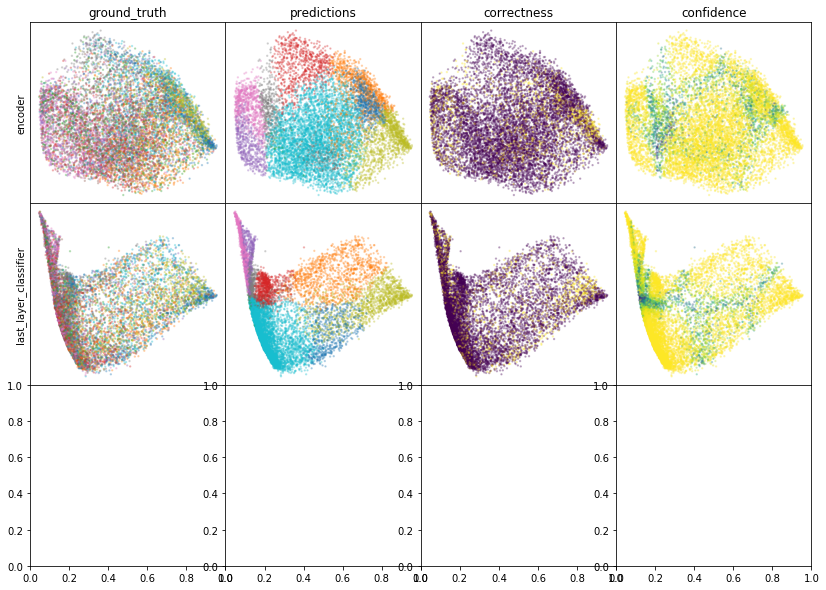

W0807 05:35:23.719570 139770049615616 legend.py:1282] No handles with labels found to put in legend.
W0807 05:35:23.920128 139770049615616 legend.py:1282] No handles with labels found to put in legend.
W0807 05:35:24.121042 139770049615616 legend.py:1282] No handles with labels found to put in legend.


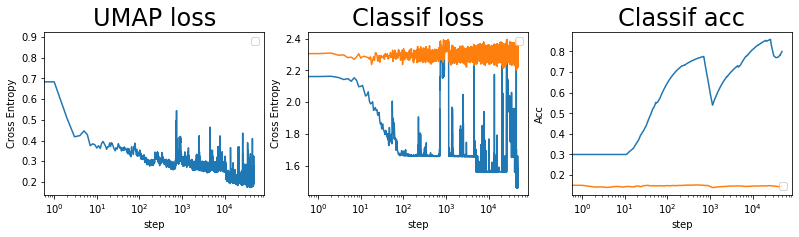

batch: 49000 | train acc: 0.8 | val acc: 0.146


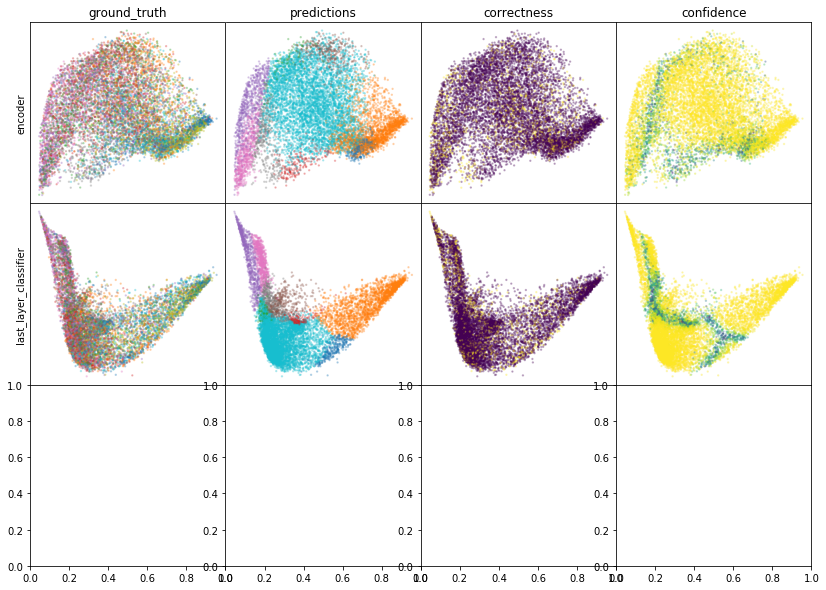

W0807 05:46:36.084723 139770049615616 legend.py:1282] No handles with labels found to put in legend.
W0807 05:46:36.281800 139770049615616 legend.py:1282] No handles with labels found to put in legend.
W0807 05:46:36.489407 139770049615616 legend.py:1282] No handles with labels found to put in legend.


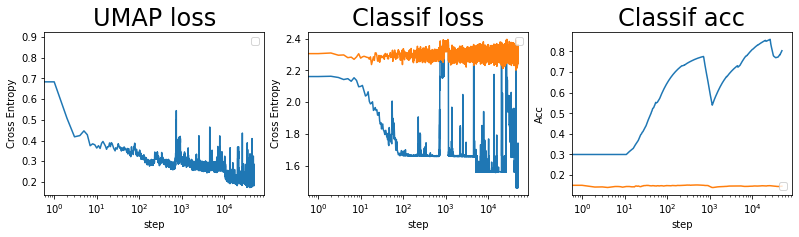

batch: 50000 | train acc: 0.8038 | val acc: 0.1461
leaving epoch because no improvement in 10000 batches


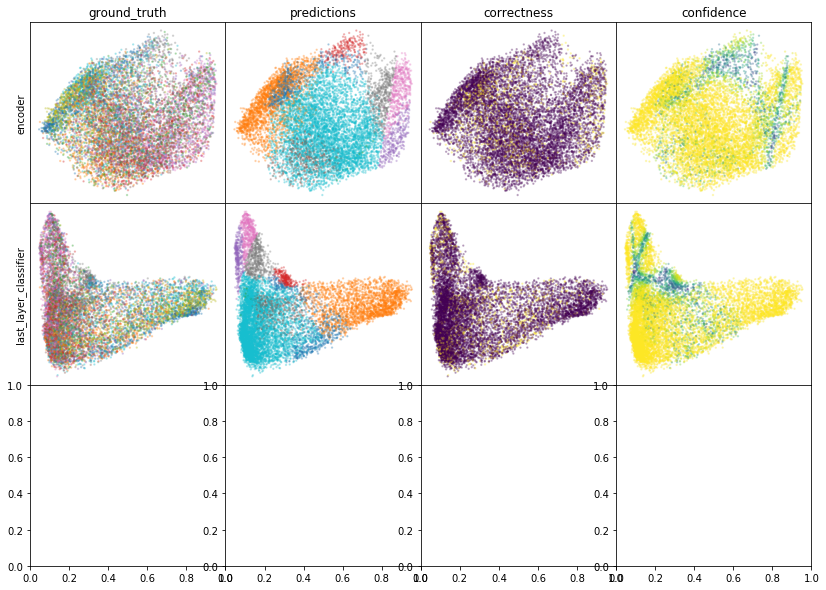

W0807 05:59:30.735262 139770049615616 legend.py:1282] No handles with labels found to put in legend.
W0807 05:59:30.955109 139770049615616 legend.py:1282] No handles with labels found to put in legend.
W0807 05:59:31.179345 139770049615616 legend.py:1282] No handles with labels found to put in legend.


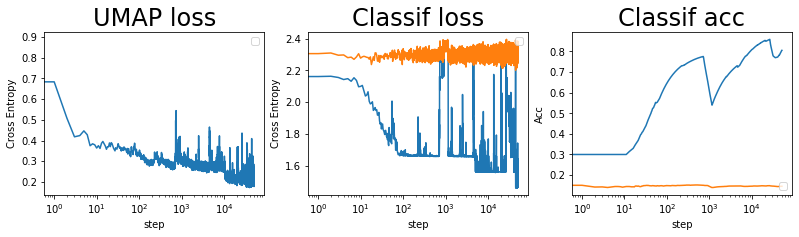

batch: 51000 | train acc: 0.8057 | val acc: 0.1457


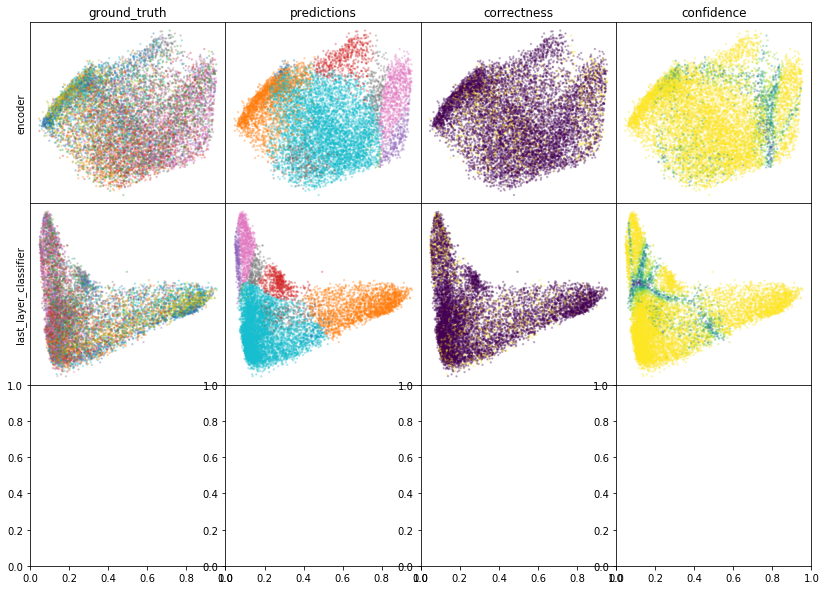

W0807 06:10:29.048093 139770049615616 legend.py:1282] No handles with labels found to put in legend.
W0807 06:10:29.249948 139770049615616 legend.py:1282] No handles with labels found to put in legend.
W0807 06:10:29.456606 139770049615616 legend.py:1282] No handles with labels found to put in legend.


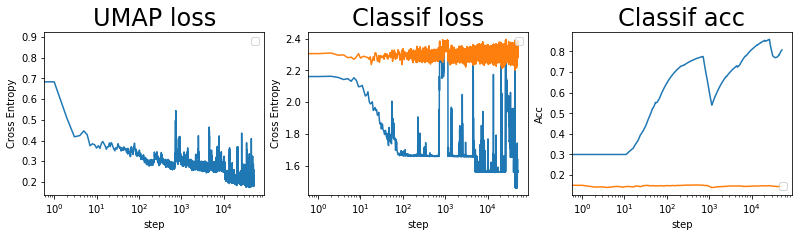

batch: 52000 | train acc: 0.8075 | val acc: 0.1452


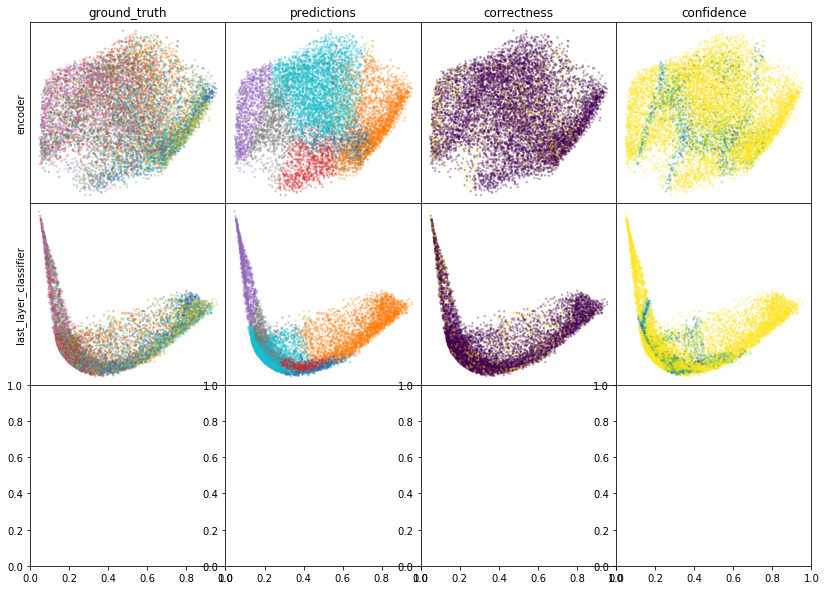

W0807 06:22:13.397434 139770049615616 legend.py:1282] No handles with labels found to put in legend.
W0807 06:22:13.602600 139770049615616 legend.py:1282] No handles with labels found to put in legend.
W0807 06:22:13.811666 139770049615616 legend.py:1282] No handles with labels found to put in legend.


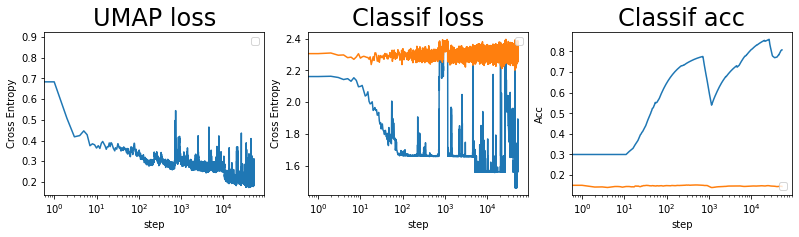

batch: 53000 | train acc: 0.808 | val acc: 0.1449


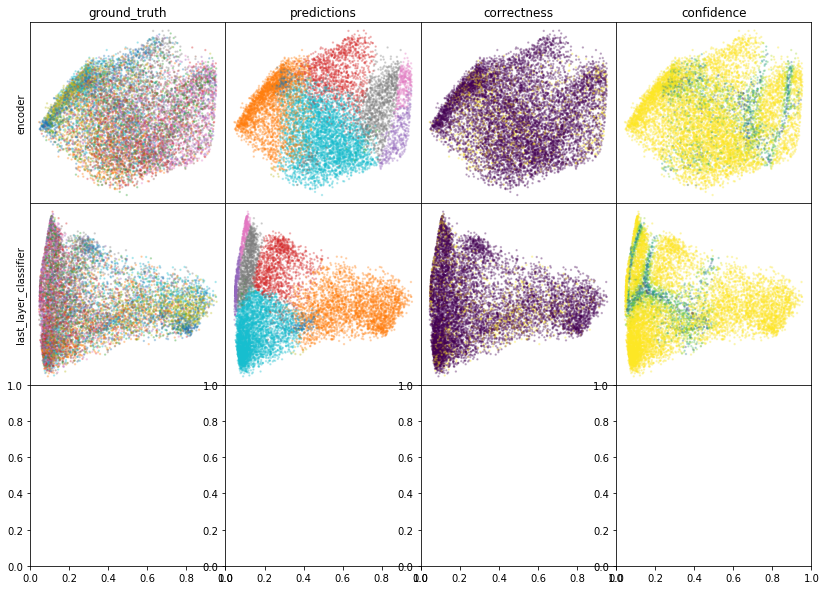

W0807 06:33:23.039732 139770049615616 legend.py:1282] No handles with labels found to put in legend.
W0807 06:33:23.249158 139770049615616 legend.py:1282] No handles with labels found to put in legend.
W0807 06:33:23.463248 139770049615616 legend.py:1282] No handles with labels found to put in legend.


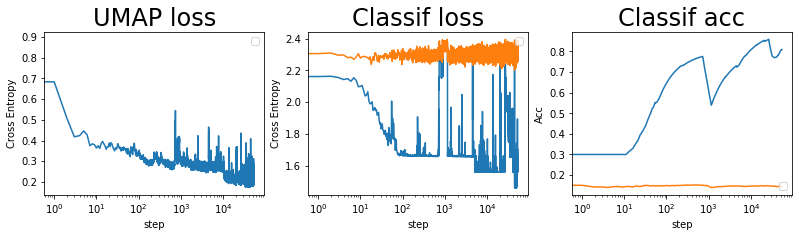

batch: 54000 | train acc: 0.8094 | val acc: 0.1444


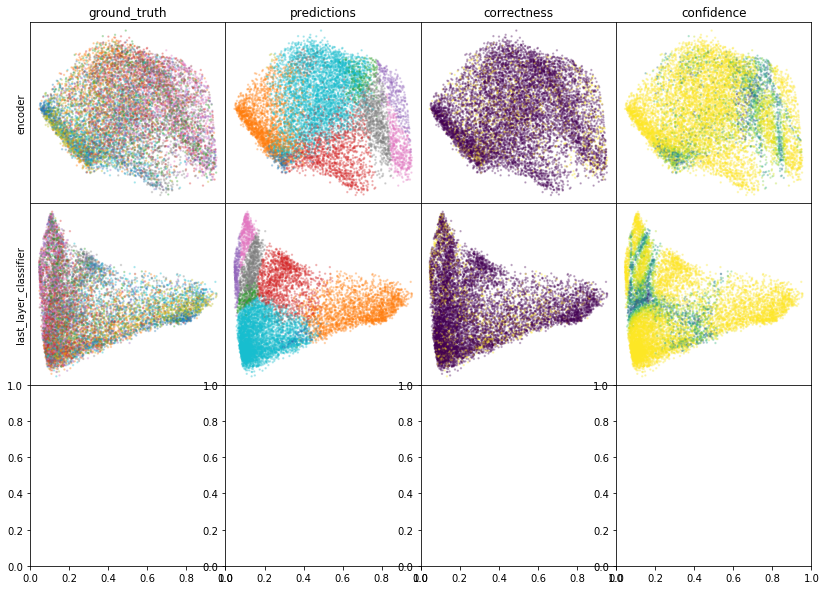

W0807 06:45:22.890708 139770049615616 legend.py:1282] No handles with labels found to put in legend.
W0807 06:45:23.103863 139770049615616 legend.py:1282] No handles with labels found to put in legend.
W0807 06:45:23.321739 139770049615616 legend.py:1282] No handles with labels found to put in legend.


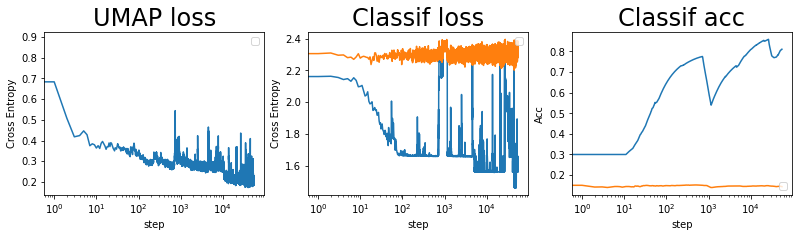

batch: 55000 | train acc: 0.8111 | val acc: 0.1439


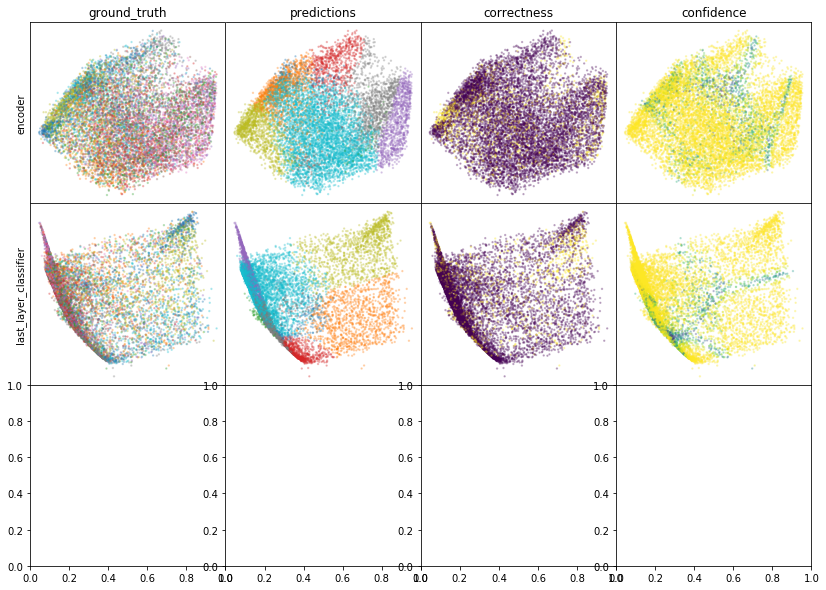

W0807 06:56:34.226335 139770049615616 legend.py:1282] No handles with labels found to put in legend.
W0807 06:56:34.439335 139770049615616 legend.py:1282] No handles with labels found to put in legend.
W0807 06:56:34.656342 139770049615616 legend.py:1282] No handles with labels found to put in legend.


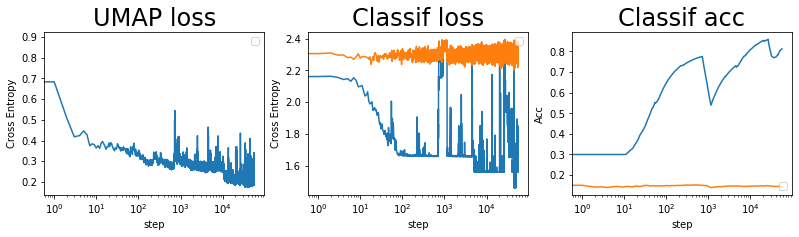

batch: 56000 | train acc: 0.8126 | val acc: 0.1438


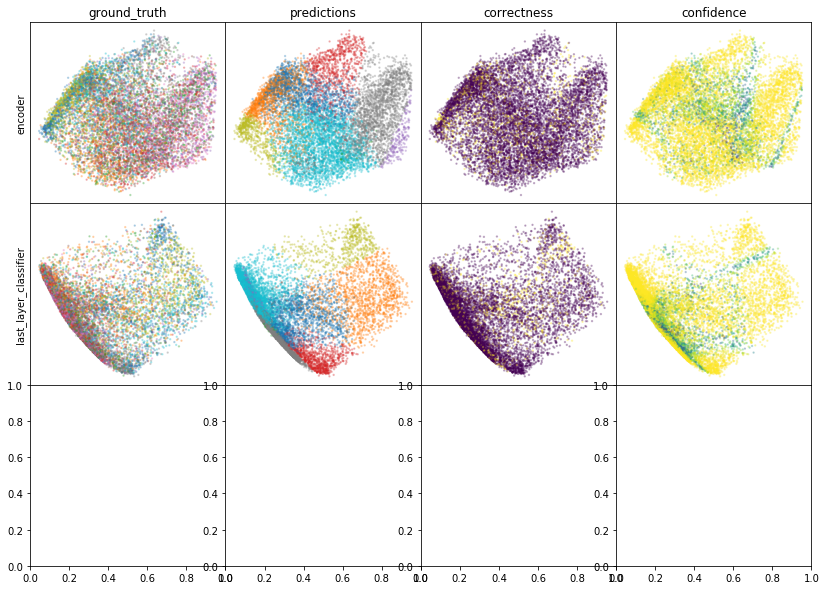

W0807 07:08:24.541634 139770049615616 legend.py:1282] No handles with labels found to put in legend.
W0807 07:08:24.757117 139770049615616 legend.py:1282] No handles with labels found to put in legend.
W0807 07:08:24.974831 139770049615616 legend.py:1282] No handles with labels found to put in legend.


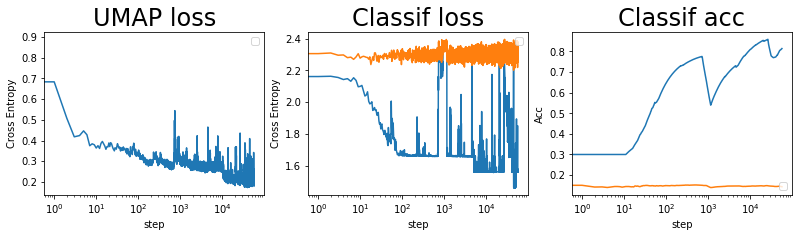

batch: 57000 | train acc: 0.8141 | val acc: 0.1435


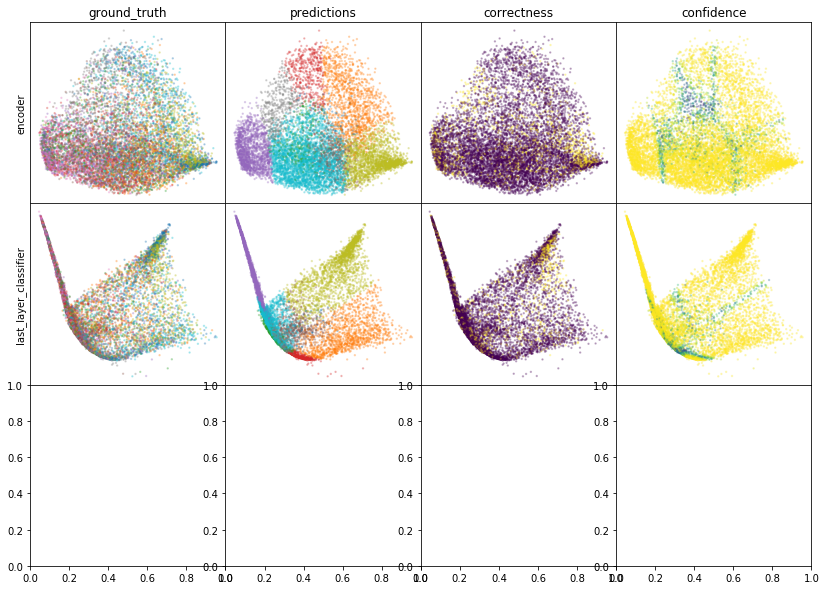

W0807 07:19:59.249356 139770049615616 legend.py:1282] No handles with labels found to put in legend.
W0807 07:19:59.468890 139770049615616 legend.py:1282] No handles with labels found to put in legend.
W0807 07:19:59.690832 139770049615616 legend.py:1282] No handles with labels found to put in legend.


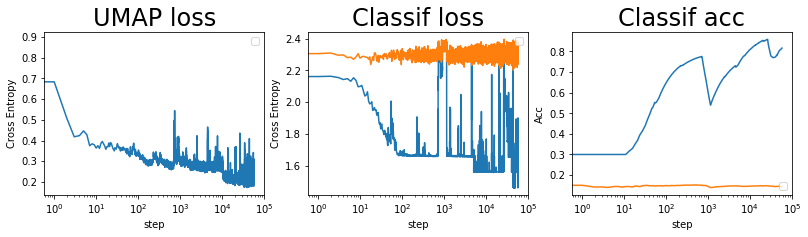

batch: 58000 | train acc: 0.8165 | val acc: 0.1435


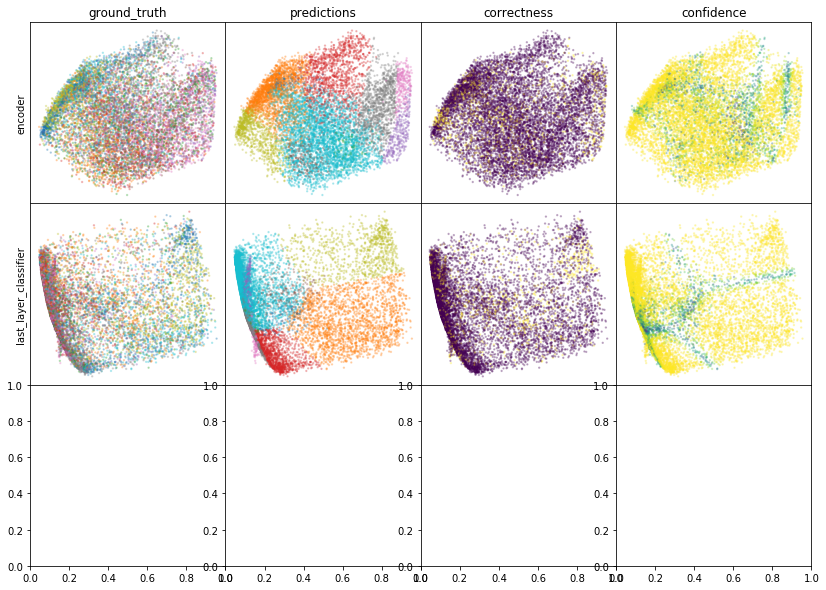

W0807 07:31:50.359299 139770049615616 legend.py:1282] No handles with labels found to put in legend.
W0807 07:31:50.582115 139770049615616 legend.py:1282] No handles with labels found to put in legend.
W0807 07:31:50.808698 139770049615616 legend.py:1282] No handles with labels found to put in legend.


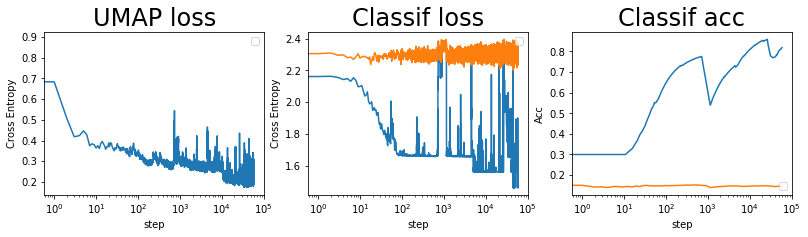

batch: 59000 | train acc: 0.819 | val acc: 0.1433


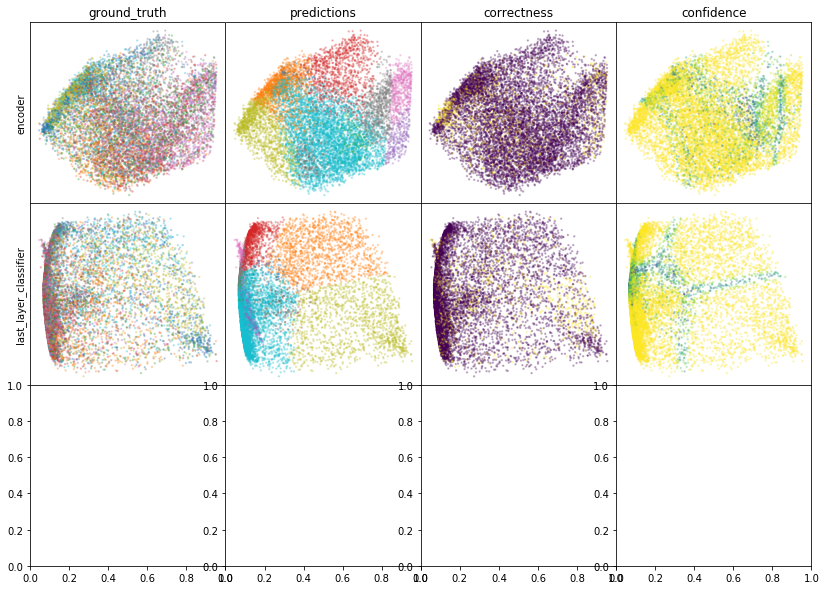

W0807 07:43:00.374816 139770049615616 legend.py:1282] No handles with labels found to put in legend.
W0807 07:43:00.598433 139770049615616 legend.py:1282] No handles with labels found to put in legend.
W0807 07:43:00.827047 139770049615616 legend.py:1282] No handles with labels found to put in legend.


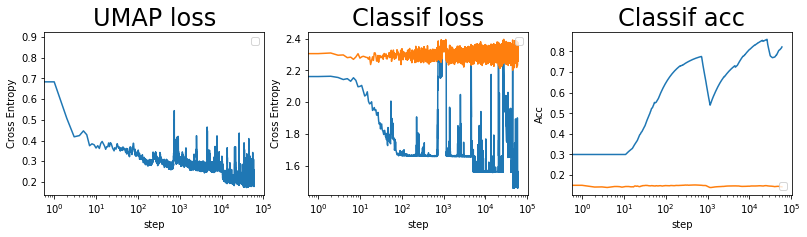

batch: 60000 | train acc: 0.822 | val acc: 0.1431


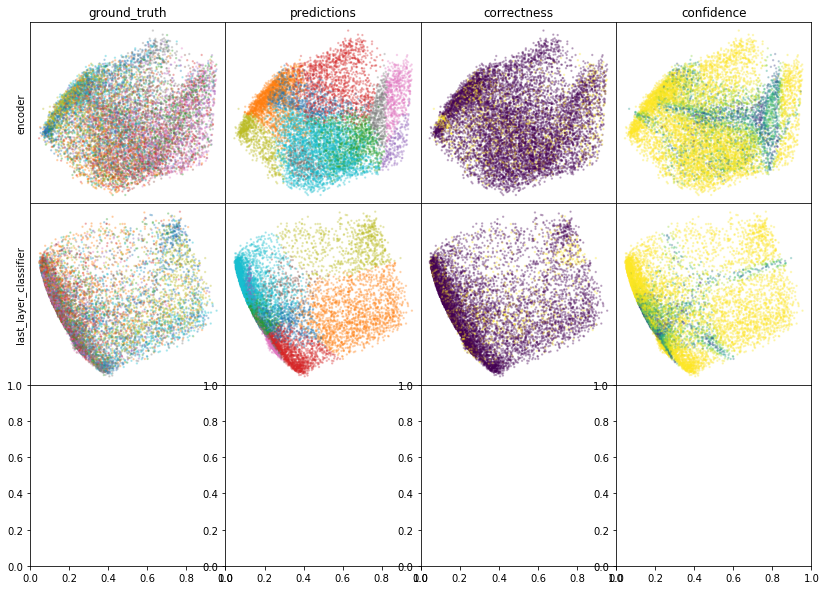

W0807 07:54:43.316944 139770049615616 legend.py:1282] No handles with labels found to put in legend.
W0807 07:54:43.546846 139770049615616 legend.py:1282] No handles with labels found to put in legend.
W0807 07:54:43.781794 139770049615616 legend.py:1282] No handles with labels found to put in legend.


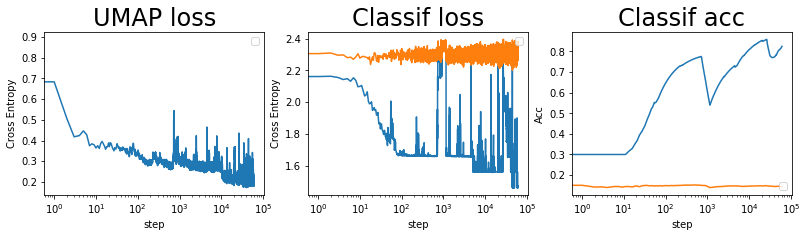

batch: 61000 | train acc: 0.8249 | val acc: 0.1429
leaving epoch because no improvement in 10000 batches


KeyboardInterrupt: 

In [54]:
improved_this_epoch = True
for epoch in tqdm(zip(np.arange(N_EPOCHS)), total=N_EPOCHS, desc="epoch"):

    if not improved_this_epoch:
        epochs_without_improvement += 1

    if epochs_without_improvement > max_epochs_without_improvement:
        print(
            "Early stopping because no improvement in {} epochs".format(
                max_epochs_without_improvement
            )
        )
        break

    # reset improvement information
    improved_this_epoch = False
    last_improvement = (
        0  # delta between current batch, and the last batch that was an improvement
    )
    n_reloads = 0
    batches_since_last_reload = 0

    ####  build graph
    # embed data
    train_enc = model_data(X_train, 100, model.encoder)
    train_last_layer = model_data(train_enc, 100, pred_model)

    # construct graph
    umap_graph = build_fuzzy_simplicial_set(
        train_last_layer, y=Y_masked, n_neighbors=n_neighbors,
    )
    # get graph elements
    graph, epochs_per_sample, head, tail, weight, n_vertices = get_graph_elements(
        umap_graph, n_epochs=200
    )

    # create edge iterator
    edge_epoch, n_edges_per_epoch = create_edge_iterator(
        head,
        tail,
        weight,
        batch_size=batch_size,
        max_sample_repeats_per_epoch=max_sample_repeats_per_epoch,
    )

    BATCHES_PER_EPOCH = int(n_edges_per_epoch / batch_size)
    
    samples_left = 0

    pbar = tqdm(total=BATCHES_PER_EPOCH, leave=False, desc="loss")

    for (batch_to, batch_from), (X, y), (X_val, y_val) in zip(
        edge_epoch, labeled_iter, data_valid
    ):
        
        # redo augmentation if on average, 
        if samples_left <= 0:
            X_train_aug = next(img_data_gen.flow(X_train, shuffle=False, batch_size=len(X_train)))
            samples_left = len(X_train)*repeat_augment_tolerance
        samples_left -= batch_size*2
        
        # train
        (
            attraction_loss,
            repellant_loss,
            umap_loss,
            classifier_loss,
            classifier_acc,
        ) = model.train(batch_to=X_train_aug[np.array(batch_to)], batch_from=X_train_aug[np.array(batch_from)], X=X, y=y, umap_prop = umap_prop)
        
        
        # compute validation loss
        val_loss, val_acc = compute_classifier_loss(
            X_val,
            y_val,
            model.encoder,
            model.classifier,
            model.sparse_ce,
            model.class_acc_val,
        )
        
        pbar.update()
        pbar.set_description("val acc: {}".format(str(round(val_acc.numpy(), 5))))

        # save losses
        model.write_losses(
            tf.convert_to_tensor(batch, dtype=tf.int64),
            classifier_acc,
            classifier_loss,
            umap_loss,
            val_loss,
            val_acc,
        )

        # plot results
        if batch % plot_frequency == 0:
            plot_umap_classif_results(
                model,
                X_valid,
                Y_valid,
                X_train,
                X_labeled,
                Y_labeled,
                batch_size,
                cmap="tab10",
                cmap2="tab10",
            )
            print(
                "batch: {} | train acc: {} | val acc: {}".format(
                    str(batch),
                    str(round(classifier_acc.numpy(), 4)),
                    str(round(val_acc.numpy(), 4)),
                )
            )

        # make any improvement isn't a fluke of small batch size
        if batches_since_last_reload >= reload_tolerance:

            # save if validation accuracy went up
            if val_acc > best_saved_acc + max_save_delta:
                # save weights
                print(
                    "saving weights | batch = {} | acc = {}".format(
                        batch, round(val_acc.numpy() * 100, 3)
                    )
                )
                model.encoder.save_weights((cpt_path / "encoder").as_posix())
                model.classifier.save_weights((cpt_path / "classifier").as_posix())
                best_saved_acc = val_acc.numpy()
                # save batch number
                best_saved_batch = copy.deepcopy(batch)

            # reinitialize if validation accuracy went down
            if val_acc < (best_saved_acc - max_reinitialize_delta):
                # if
                if batches_since_last_reload >= reload_tolerance:
                    batches_since_last_reload = 0
                    lr = model.optimizer.lr.numpy()
                    print(
                        "batch {} | acc = {} | learn rate = {} | reloading weights from batch {} at acc {} | n reloads = {}".format(
                            batch,
                            str(round(val_acc.numpy(), 3)),
                            lr,
                            best_saved_batch,
                            int(best_saved_acc * 100),
                            n_reloads,
                        )
                    )
                    # reload weights
                    model.encoder.load_weights((cpt_path / "encoder").as_posix())
                    model.classifier.load_weights((cpt_path / "classifier").as_posix())

                    # set new learning rate
                    model.optimizer.lr.assign(lr / 2)

                    batch += 1
                    n_reloads += 1

                    # stop if reloaded too many times
                    if n_reloads >= max_reloads:
                        break

            # if there is an imporovement, set new best score
            if val_acc > best_acc + min_delta:
                improved_this_epoch = True
                last_improvement = 0
                best_acc = val_acc
            # if the model has not improved in patience batches, end epoch
            elif last_improvement >= patience:
                last_improvement = 0
                print(
                    "leaving epoch because no improvement in {} batches".format(
                        patience
                    )
                )
                break
            else:
                last_improvement += 1

        # up the ticker
        batch += 1
        batches_since_last_reload += 1
    pbar.close()

In [70]:
test_enc = model_data(X_test, batch_size, model.encoder)

In [71]:
y_pred = model_data(test_enc, batch_size, model.classifier)

In [72]:
test_acc = tf.keras.metrics.sparse_categorical_accuracy(
    Y_test, y_pred
).numpy()
print(np.mean(test_acc))

0.1022


In [76]:
z_enc = model_data(X_train, 100, encoder)
last_layer_class = model_data(z_enc, batch_size, pred_model)
z_pred = model_data(z_enc, batch_size, classifier)
confidence = np.max(z_pred, axis = 1)
umap_class = UMAP(verbose=True).fit_transform(last_layer_class, Y_masked)
classifications = np.argmax(z_pred, axis=1)
correctness = classifications == Y_train
np.save(cpt_path / 'train_last_layer_class.npy', last_layer_class)
np.save(cpt_path / 'train_z_enc.npy', z_enc)
np.save(cpt_path / 'train_last_layer_class_umap.npy', umap_class)

UMAP(dens_frac=0.0, dens_lambda=0.0, verbose=True)
Construct fuzzy simplicial set
Fri Aug  7 09:26:58 2020 Finding Nearest Neighbors
Fri Aug  7 09:26:58 2020 Building RP forest with 15 trees
Fri Aug  7 09:26:59 2020 parallel NN descent for 15 iterations
	 0  /  15
	 1  /  15
Fri Aug  7 09:27:00 2020 Finished Nearest Neighbor Search
Fri Aug  7 09:27:00 2020 Construct embedding
	completed  0  /  200 epochs
	completed  20  /  200 epochs
	completed  40  /  200 epochs
	completed  60  /  200 epochs
	completed  80  /  200 epochs
	completed  100  /  200 epochs
	completed  120  /  200 epochs
	completed  140  /  200 epochs
	completed  160  /  200 epochs
	completed  180  /  200 epochs
Fri Aug  7 09:27:33 2020 Finished embedding


In [75]:
np.save(cpt_path / 'test_acc.npy', test_acc)

In [ ]:
z_enc = model_data(X_valid, 100, encoder)
last_layer_class = model_data(z_enc, batch_size, pred_model)
z_pred = model_data(z_enc, batch_size, classifier)
confidence = np.max(z_pred, axis = 1)

valid_acc = tf.keras.metrics.sparse_categorical_accuracy(
    Y_valid, z_pred
).numpy()
print(np.mean(valid_acc))

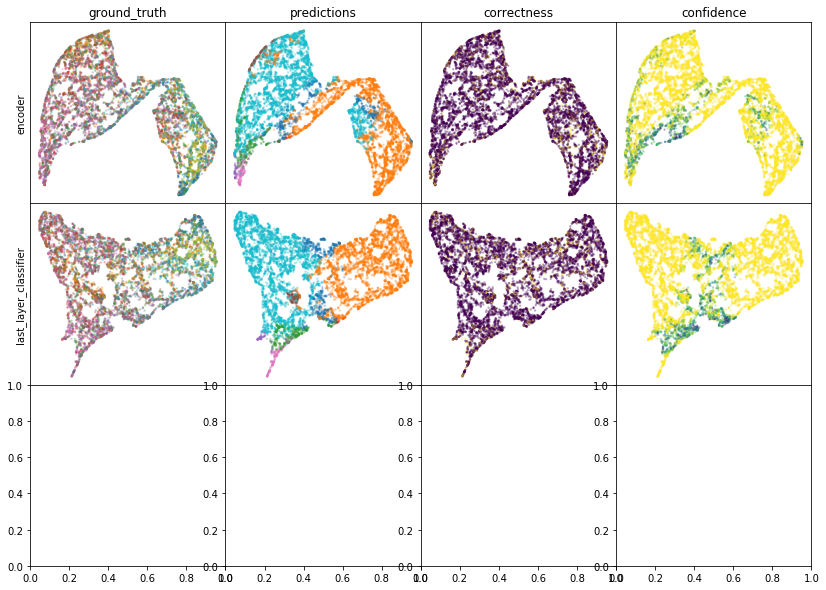

W0807 08:04:52.003503 139770049615616 legend.py:1282] No handles with labels found to put in legend.
W0807 08:04:52.234059 139770049615616 legend.py:1282] No handles with labels found to put in legend.
W0807 08:04:52.466215 139770049615616 legend.py:1282] No handles with labels found to put in legend.


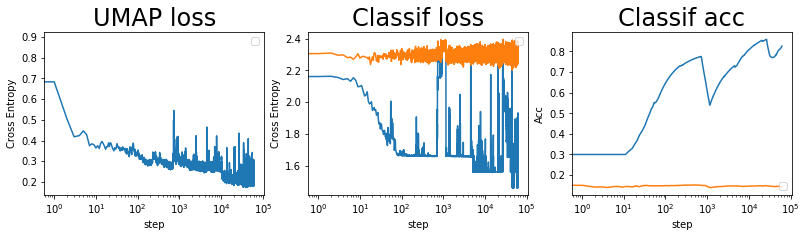

In [60]:
plot_umap_classif_results(model, X_valid, Y_valid, X_train, X_labeled, Y_labeled, batch_size, dralg=UMAP, cmap='tab10', cmap2='tab10')